# <font color='red'>TME ROBOTIQUE ET APPRENTISSAGE</font>
# <font color='red'>Stratégies d'Evolution et Robotique Autonome</font>

<font color="red">Version étudiant 2023</font>

<b><font color='green'>GROUPES 1 et 2</font></b>

*mise à jour: 9/3/2023*

Ce notebook doit être exécuté dans [Google Colab](colab.research.google.com/) (mais vous pouvez aussi l'utiliser avec Jupyter Lab)

Vous devez déposer votre travail sur Moodle:
* déposer votre notebook, avec le nom de fichier *obligatoirement* au format suivant: **RA_NOM1_NOM2.ipynb**. 
* toutes les cellules exécutées
* des graphes et un commentaire *court* lorsque cela est demandé
* la partie B est à faire en autonomie
* la partie C ne sera pas évaluée

*Le sujet est à faire en binome.*

# COMPLETEZ LES CHAMPS CI-DESSOUS AVEC NOM/PRENOM/CARTE_ETU:

* Étudiant 1: **_CELLIER_ _Roxane_ _21205907_**
* Étudiant 2: **_MOULIN-ROUSSEL_ _Lou_ _3676580_**



# <font color='orange'>PARTIE A: optimisation dans un espace de recherche continu</font>

# Importation des librairies et définition des fonctions utiles pour la partie A

Remarque: *Il est nécessaire d'exécuter ces cellules une seule fois. En cas de redémarrage du noyau, il faut relancer ces cellules. Il n'est pas nécessaire de regarder le code de ces cellules, elles servent seulement de soutien à la partie A.*

In [2]:
from datetime import datetime
from datetime import date
#import importlib # une seule fois
import sys
import random
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
import numpy as np
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from scipy.optimize import minimize

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:56:43 GMT
OK.


In [3]:
#!pip install numpy scipy matplotlib pandas sympy nose
!pip install deap
!pip install cma
#!pip install --user pygame

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

 2023-03-16 21:56:55 GMT
OK.


In [4]:
# plot

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
import numpy as np
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
import random
from scipy.optimize import minimize


def plot_results(my_func, my_points, min_x=-30, max_x=30, min_y=-30, max_y=30, nbx=100, nby=100, title="Title"):
    """Plots a 2D function with a heatmap and the points given as argument are plotted on top of it

    Plots a 2D function with a heatmap and the points given as argument are plotted on top of it:
    :param my_func: the function to plot on the background
    :param my_points: the points to plot
    :param min_x: min value of x
    :param max_x: max value of x
    :param min_y: min value of y
    :param max_y: max value of y
    :param nbx: number of my_func samples on the X-axis
    :param nby: number of my_func samples on the Y-axis
    :param title: title of the figure
    """
    X = np.linspace(min_x, max_x, num=nbx)
    Y = np.linspace(min_y, max_y, num=nby)
    Z=np.zeros((nbx,nby),dtype=np.double)
    for i in range(nbx):
        for j in range(nby):
            Z[i][j]=my_func([X[i],Y[j]])
    fig,ax=plt.subplots(figsize=(5,5))
    ax.set_xlim(min_x,max_x)
    ax.set_ylim(min_y,max_y)
    ax.imshow(Z, cmap='hot', interpolation='nearest',extent=(min_x,max_x,min_y,max_y))
    
    #print("Points: "+str(my_points))
    x=[]
    y=[]
    for p in my_points:
        x.append(p[0])
        y.append(p[1])

    ax.plot(x,y,".")
    ax.set_title(title)
    plt.show()

def plot_violin(res):
    """ Makes a violin plot of the results provided in the argument

    Makes a violin plot of the results provided in the argument.
    :param res: dictionary of the results to plot. The key is the name and the data is a vector of performance values.
    """
    fig,ax=plt.subplots(figsize=(5,5))
    data=[]
    labels=[]
    for k in res.keys():
        data.append(res[k])
        labels.append(k)
    ax.violinplot(data,
                   showmeans=False,
                   showmedians=True)
    ax.set_title('Violin plot')
    # adding horizontal grid lines
    ax.yaxis.grid(True)
    ax.set_xticks([y + 1 for y in range(len(data))])
    ax.set_xlabel('Optimization methods')
    ax.set_ylabel('Best value found')

    # add x-tick labels
    plt.setp(ax, xticks=[y + 1 for y in range(len(data))],
        xticklabels=labels)
    plt.setp(ax.get_xticklabels(), rotation=30, ha="right")
    plt.show()
  
print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:56:55 GMT
OK.


In [5]:
# myEvalFn
# requires: CMA

import sys
import cma
import cma.purecma as purecma
from deap import benchmarks

def ackley(x):
    return benchmarks.ackley(x)[0]

def sphere(x):
    return benchmarks.sphere(x)[0]

def rastrigin(x):
    return benchmarks.rastrigin(x)[0]


#### #### ####

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:56:55 GMT
OK.


In [6]:
# myEvalFn

def ackley(x):
    return benchmarks.ackley(x)[0]

def sphere(x):
    return benchmarks.sphere(x)[0]

def rastrigin(x):
    return benchmarks.rastrigin(x)[0]

init_pSG = False # WARNING: pSG.initAll() should NEVER be called BEFORE calling explore(.)
def explore(x):  # NOTE: display should be false whenever an optimiser is called
    global init_pSG
    if init_pSG == False:
        pSG.initAll()
        init_pSG = True
    return -pSG.evaluate(x)   # remember: we minimise!

#### #### ####

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:56:55 GMT
OK.


---

# Exercice A-0: recherche au hasard

Etudiez le code ci-dessous. Il s'agit d'un algorithme de recherche aléatoire, qui explore l'environnement naïvement et stocke le meilleur score obtenu jusqu'ici. Vous testerez cette bibliothèque sur la fonction de Sphere, Ackley, puis Rastrigin, en dimension 2 pour l'instant. Observez l'évolution de la population. 

Dans les exercices suivants, vous pouvez utiliser ce code comme point de départ en le modifiant librement.

Remarque: la variable *dimensions* définit le nombre de dimensions du problème. Dans l'exemple ci-dessous, le nombre de dimensions est fixé arbitrairement à 16. Notez que la fonction *plot_results* n'affiche que les deux premières dimensions, d'ou le fait que le meilleur individu peut s'approcher ou s'éloigner du centre (ou se trouve la meilleure solution). Vous pouvez aussi tester ce code (ainsi que ceux que vous écrirez) avec 2 dimensions seulement. La convergence sera plus rapide (voire très rapide), mais le rendu sera plus fidèle à l'exploration de l'espace de recherche, puisqu'entièrement représenté.

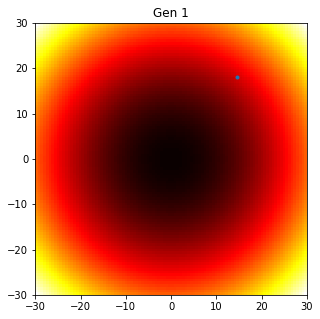

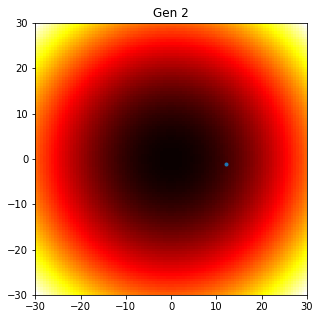

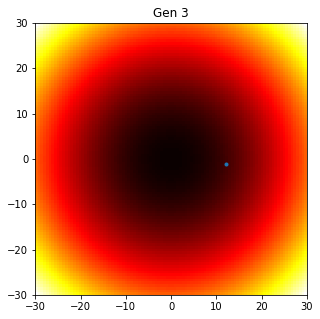

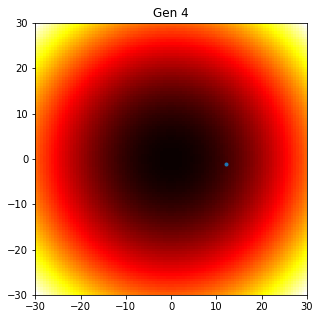

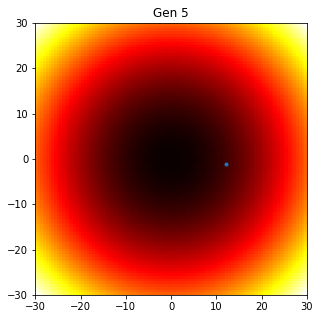

...

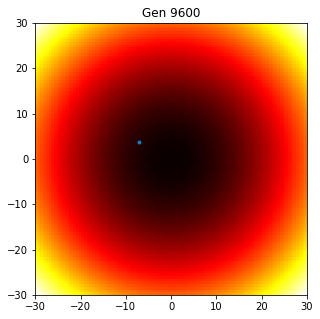

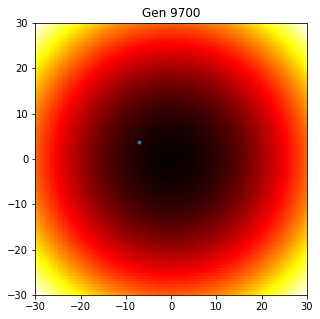

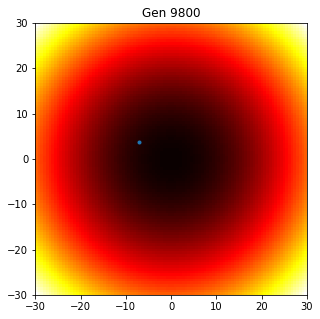

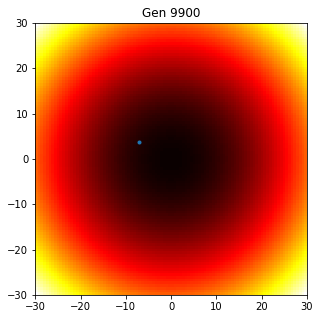

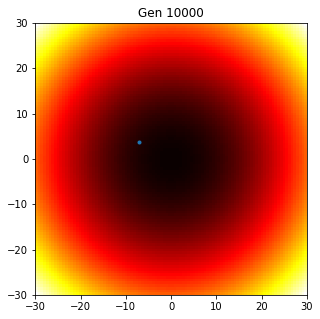

Best fit 594.448727387675 at iteration 4451
Terminé.


In [17]:
# fourni a titre d'exemple, ne pas modifier -- reprendre ce code et le modifier dans les cellules suivantes pour répondre aux questions.

def launch_random(individual, nbeval=10000, display=True, ma_func=sphere):
    parent = np.array(individual)
    i=0
    j=0
    parentFit = ma_func(individual)
    bestFit = parentFit
    bestIt = 0
    while i<nbeval:
        child = np.random.uniform(-20,20,len(individual))
        childFit = ma_func(child)
        if childFit <= parentFit:
            parentFit = childFit
            parent = np.copy(child)
            if bestFit > parentFit:
                bestFit = parentFit
                bestIt = i
        j+=1
        solutions = np.array([parent])
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1
    print ("Best fit",bestFit,"at iteration",bestIt)
    return bestFit

dimensions = 16 # défini le nombre de dimensions de l'espace de recherche (remarque: seules les deux premières sont affichées avec la commande plot_results) 
launch_random([20]*dimensions,ma_func=sphere) # un vecteur de {dimensions} paramètres, dont on arbitrairement décidé que le point de départ était le vecteur {20,20,20,...,20}, ce qui correpond à une solution peu optimale.

print ("Terminé.")

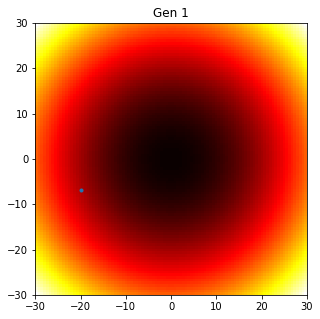

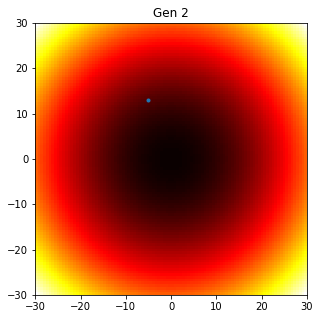

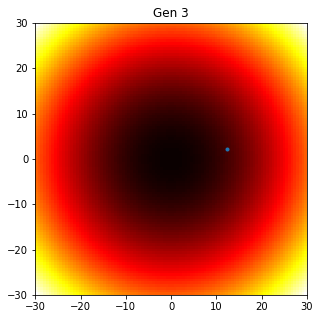

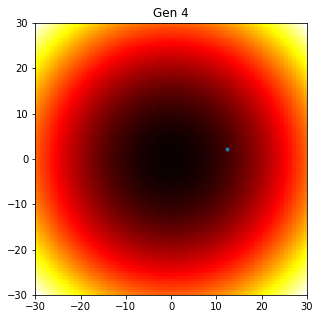

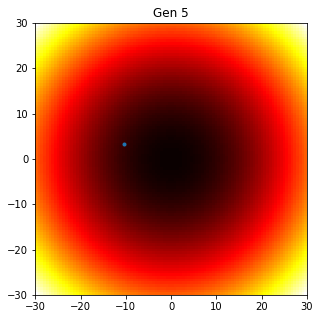

...

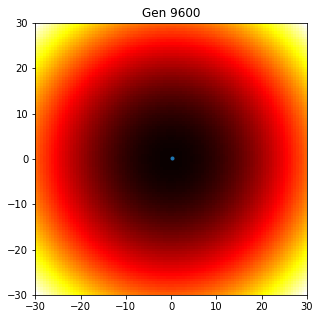

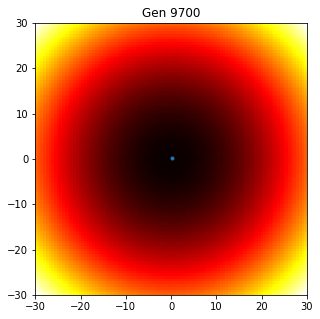

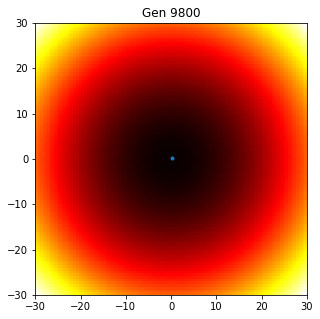

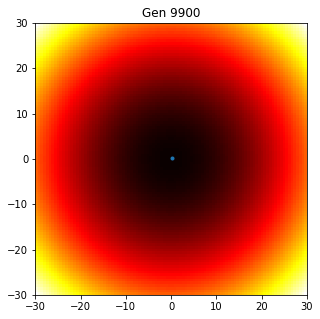

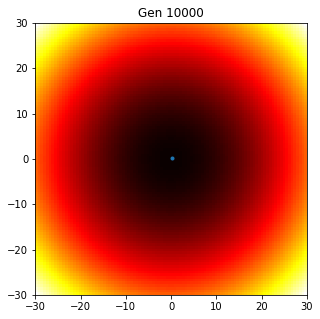

Best fit 0.01816959571611514 at iteration 8488


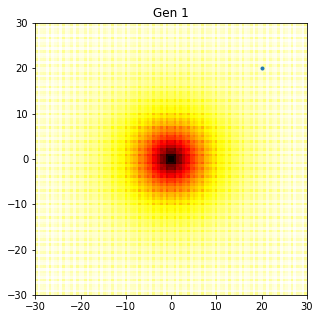

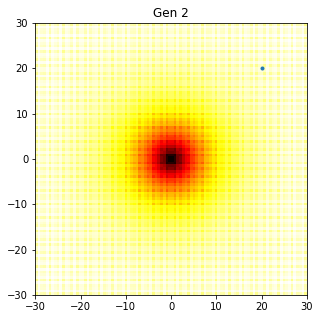

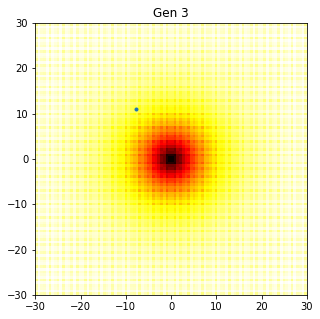

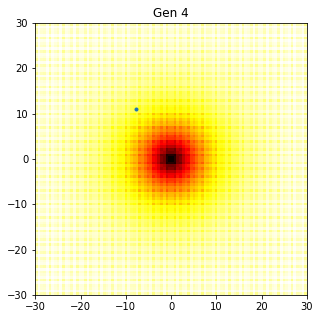

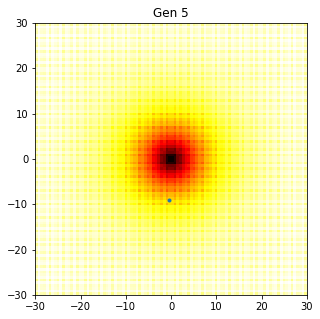

...

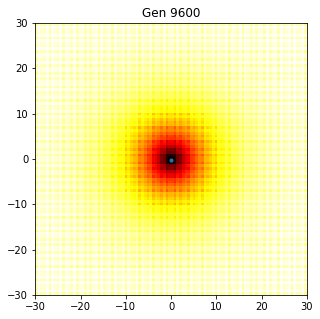

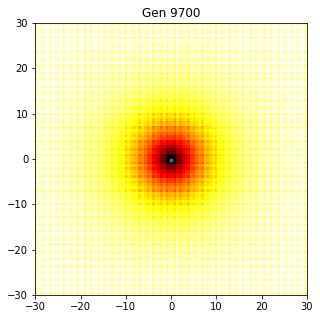

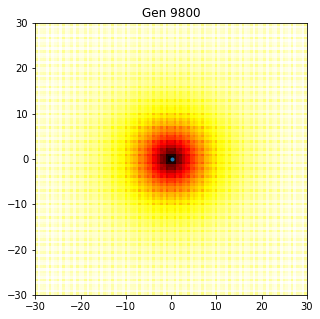

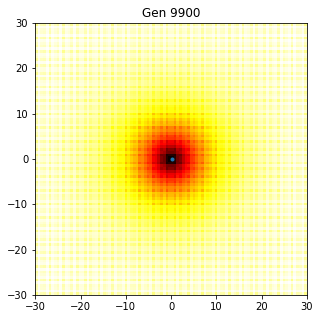

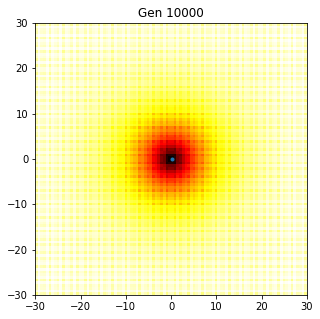

Best fit 0.9808077293086601 at iteration 9757


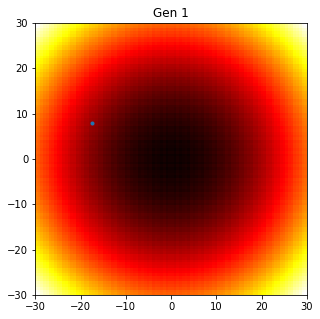

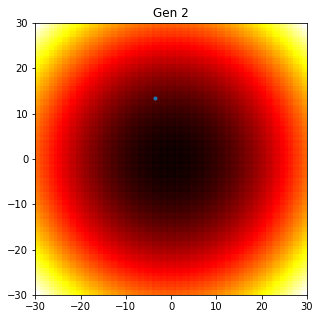

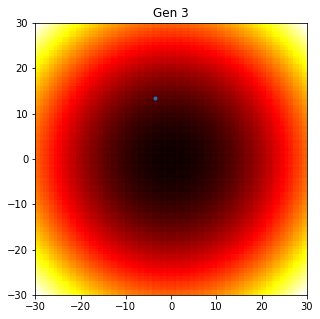

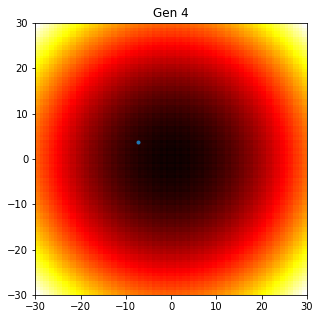

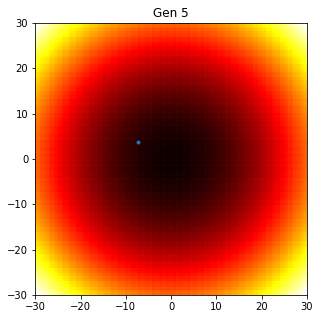

...

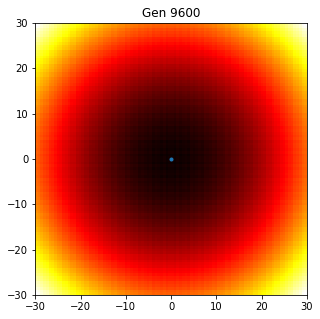

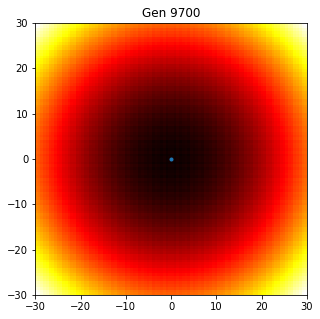

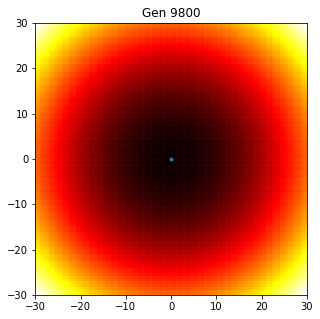

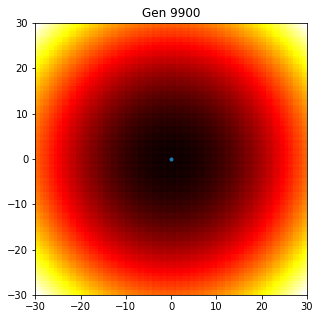

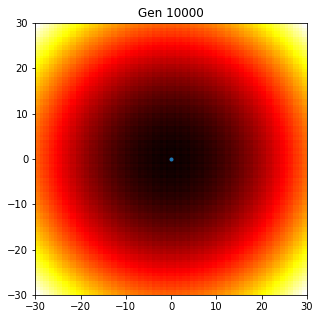

Best fit 0.28774454587113496 at iteration 5029
Terminé.


In [18]:
dimensions = 2
show = True
launch_random([20]*dimensions,ma_func=sphere, display=show) 
launch_random([20]*dimensions,ma_func=ackley, display=show) 
launch_random([20]*dimensions,ma_func=rastrigin, display=show) 
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

## Regards sur l'éxecution considérée

Sphere : Best fit 0.01816959571611514 at iteration 8488

--> très vite proche du centre

Ackley : Best fit 0.9808077293086601 at iteration 9757

--> les meilleurs points au fil des générations semblent suivre les croisements du maillage

Rastrigin : Best fit 0.28774454587113496 at iteration 5029

--> moins impacté par le maillage que précédemment

*

Dans les 3 cas --> Se rapproche vite du centre au début, mais une fois proche du centre (point optimal), il devient difficile de trouver un meilleur point par l'aléatoire. En effet le rayon de la zone proposant de meilleurs points rétrécit suivant l'amélioration, un tirage aléatoire dans la zone large à donc moins de chance de proposer un résultat intéressant.

---

# Exercice A-1: algorithme (1+1)-ES

Nous allons maintenant implementer une stratégie d'évolution (1+1)-ES avec un sigma fixe.

Vous testerez cet algorithme sur les mêmes fonctions que précédemment. Vous tracerez (comme montré à la question précédente) l'évolution de la population pour chaque exécution. Vous étudierez l'impact du choix du point initial et du sigma.

A noter que si la valeur de sigma peut influer significativement l'optimisation, l'initialisation compte aussi. Par exemple, si la solution initialement proposée se trouve dans une région ressemblant à un plateau (ie. plusieurs solutions proches obtiennent le même score), il sera difficile d'améliorer cette solution puisqu'une recherche locale s'apparentera à une marche aléatoire.

A noter aussi qu'en lançant plusieurs fois l'algorithme, vous obtiendrez des résultats différent à la fois en vitesse de convergence et de performance. Nous reviendrons sur ce point plus tard.

In [25]:
def launch_oneplusone(individual, sigma, nbeval=10000, display=True, ma_func=sphere):
    # A compléter
    parent = np.array(individual)     # initial parent

    i=0
    j=0     # (pourquoi un i ET un j, on pourrait utiliser un seul ?)

    parentFit = ma_func(individual)   # calcul fitness parent
    bestFit = parentFit
    bestIt = 0

    while i<nbeval:
        child = parent + sigma * np.random.normal(size=len(individual))     # gaussian mutation
        childFit = ma_func(child)     # calcul fitness child

        # maj du meilleur point
        if childFit <= parentFit:
            parentFit = childFit
            parent = np.copy(child)
            if bestFit > parentFit:
                bestFit = parentFit
                bestIt = i
        j+=1
        solutions = np.array([parent])
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1
    print ("Best fit",bestFit,"at iteration",bestIt)
    return bestFit

print ("Terminé.")

Terminé.


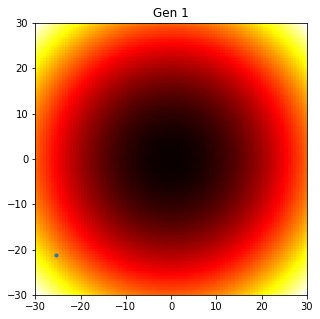

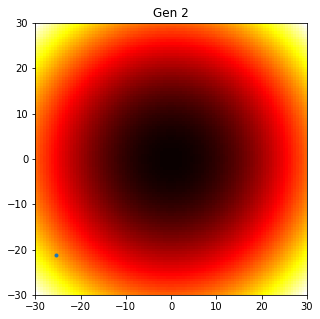

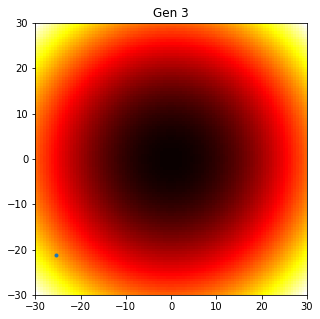

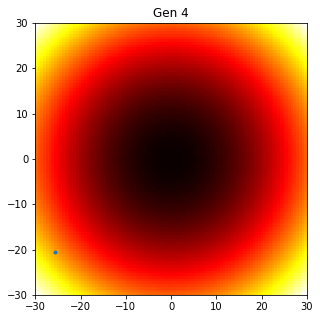

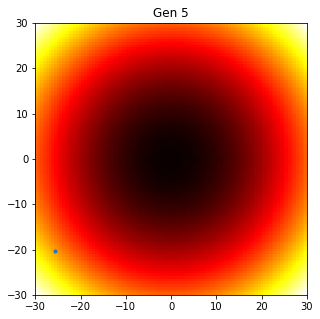

...

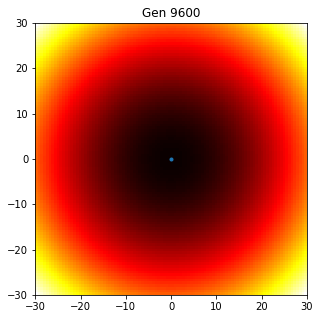

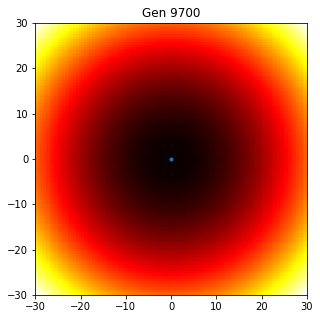

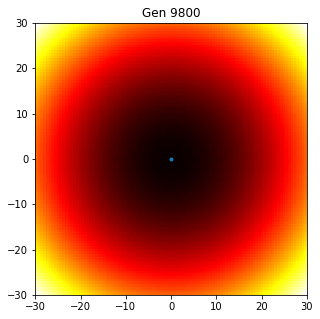

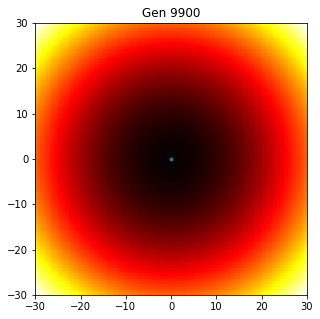

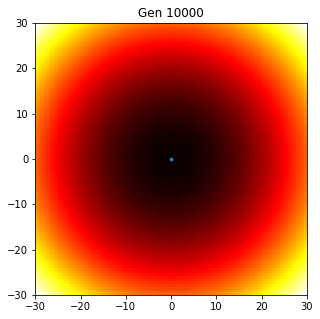

Best fit 1.6122394622954024e-05 at iteration 6619


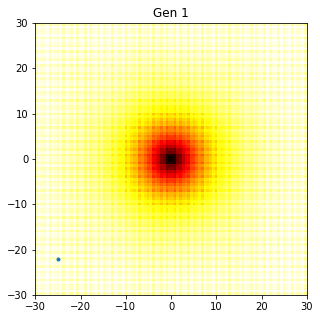

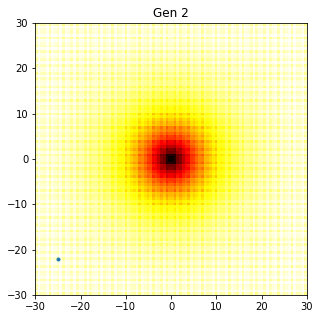

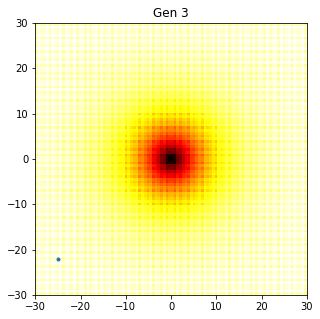

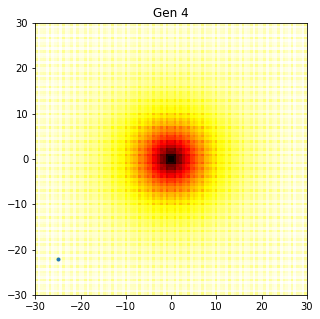

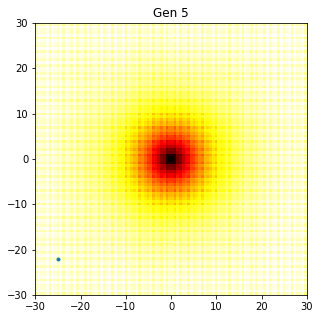

...

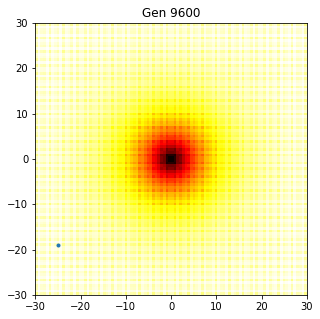

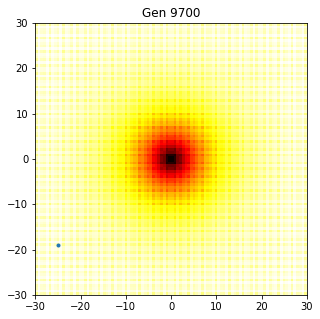

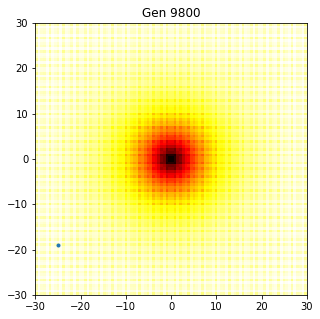

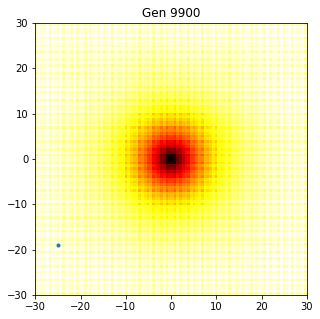

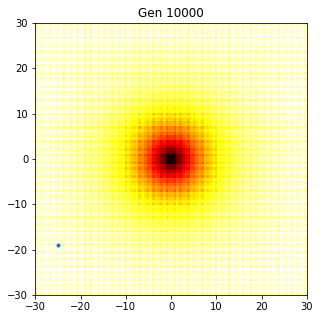

Best fit 19.76822989499542 at iteration 8749


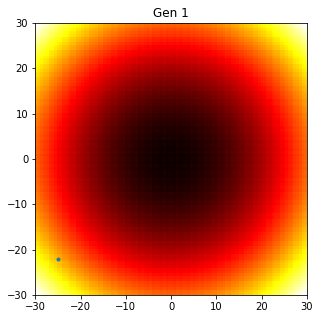

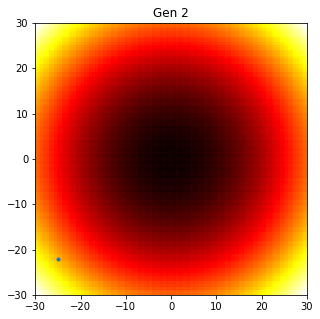

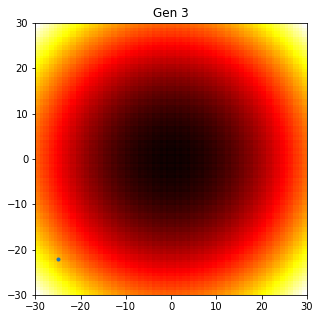

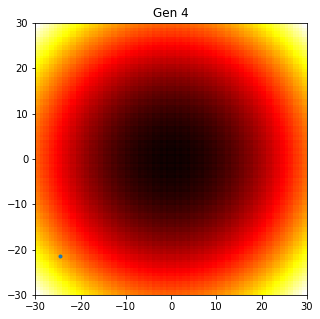

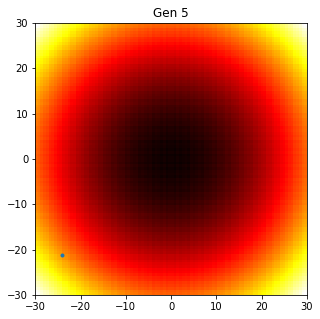

...

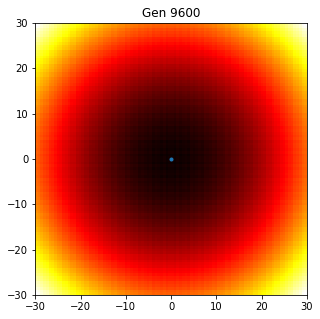

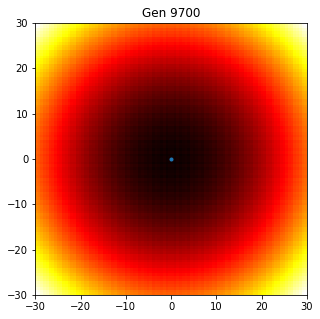

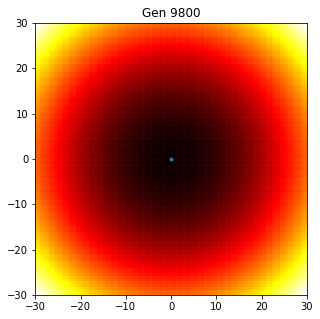

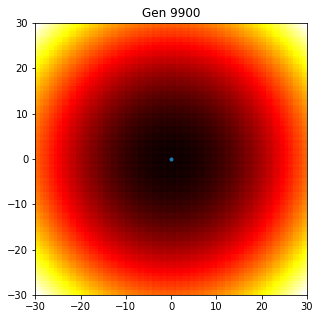

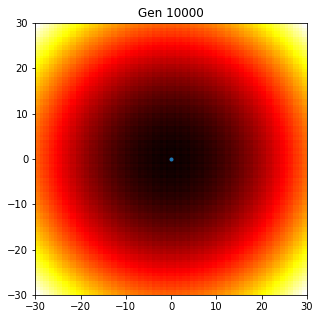

Best fit 0.0008687113733856222 at iteration 8272
Terminé.


In [30]:
dimensions = 2
sigma = 0.5
popInit = np.random.randint(-30,30, dimensions)
show = True
launch_oneplusone(popInit, sigma=sigma, ma_func=sphere, display=show) 
launch_oneplusone(popInit, sigma=sigma, ma_func=ackley, display=show) 
launch_oneplusone(popInit, sigma=sigma, ma_func=rastrigin, display=show) 
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

## Regards sur l'éxecution considérée (sigma=0.5)

Sphere : Best fit 4.644788343563286e-05 at iteration 6183

--> approche rapide vers le centre

Ackley : Best fit 0.015833683150814792 at iteration 3297

--> déplacement le long du maillage ; démarrage difficile, possibilité de rester dans un optimum local

Rastrigin : Best fit 0.007225237045268784 at iteration 9583

--> déplacement le long du maillage plus facile (maillage plus serré donc optima locaux plus proches)

*

Dans les 3 cas --> Dépent du point de départ, possibilité de rester coincé ; Best Fit meilleur que par l'aléatoire (lorsque la zone optimale est atteinte) ; Écart entre les points enfants et parents plus petit et régulier que par marche aléatoire

Un sigma grand semble accélerer la découverte d'un optimal en terme d'itération (écart possible entre enfant et parent plus grand, donc des pas plus grands), mais peut proposer un best fit moins intéressant qu'avec un sigma moyen. Un trop faible sigma ne propose pas forcement des pas suffisamement grands pour sortir d'un optimum local et se rapprocher du centre, s'il y arrive cependant il peut fournir un meilleur Best Fit.

---

# Exercice A-2: algorithme (1+1)-ES, règle des 1/5e

Nous allons maintenant implementer une stratégie d'évolution (1+1)-ES avec un sigma suivant la règle des 1/5e.

Vous testerez cette algorithme sur les mêmes fonction que précédemment. Vous tracerez l'évolution de la population pour chaque exécution. Vous étudierez l'impact du choix du point initial et du sigma.

In [33]:
def launch_ESonefifthRule(individual, sigma, nbeval=10000, display=True, ma_func=sphere):
    # A compléter  
    parent = np.array(individual)     # initial parent

    i=0
    j=0     # (pourquoi un i ET un j, on pourrait utiliser un seul ?)

    parentFit = ma_func(individual)   # calcul fitness parent
    bestFit = parentFit
    bestIt = 0

    while i<nbeval:
        child = parent + sigma * np.random.normal(size=len(individual))     # gaussian mutation
        childFit = ma_func(child)     # calcul fitness child

        # maj du meilleur point
        if childFit <= parentFit:
            parentFit = childFit
            parent = np.copy(child)
            # règle des 1/5e si enfant meilleur
            # sigm max considéré à 2
            sigma = np.minimum( sigma*2, 2)

            if bestFit > parentFit:
                bestFit = parentFit
                bestIt = i
        else:
            # règle des 1/5e si parent meilleur
            # sigma min considéré à 1e-10
            sigma = np.maximum(sigma* 2**(-1/4), 1e-10)

        j+=1
        solutions = np.array([parent])
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1
    print ("Best fit",bestFit,"at iteration",bestIt)
    return bestFit

print ("Terminé.")

Terminé.


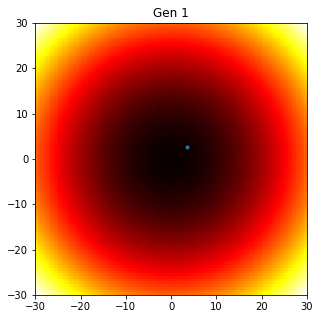

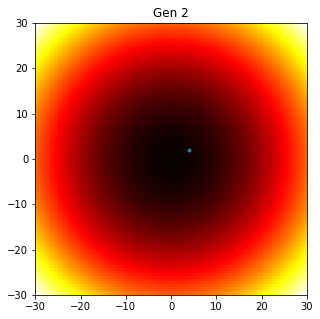

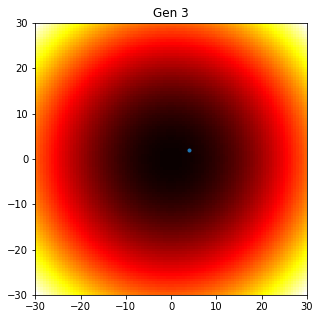

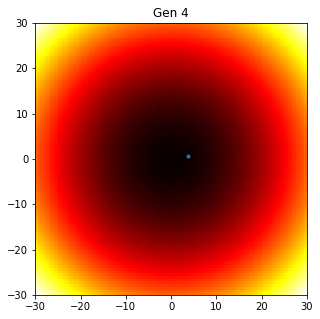

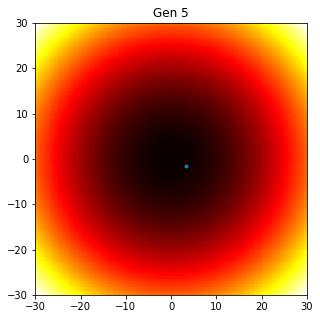

...

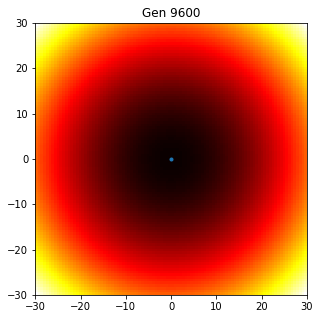

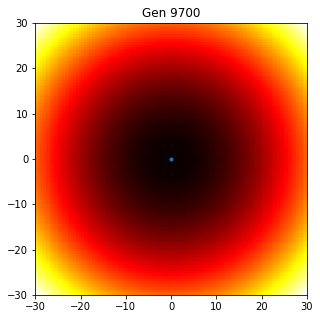

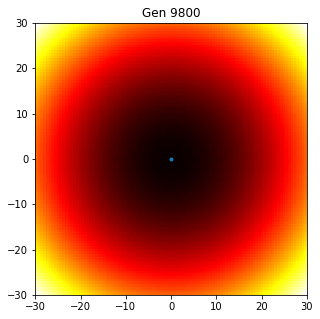

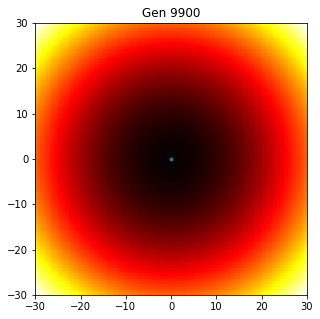

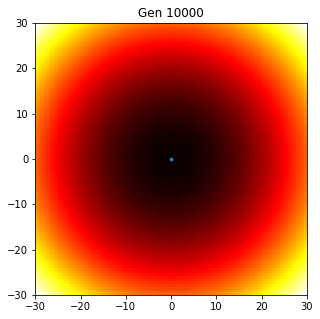

Best fit 2.023384813991675e-25 at iteration 1745


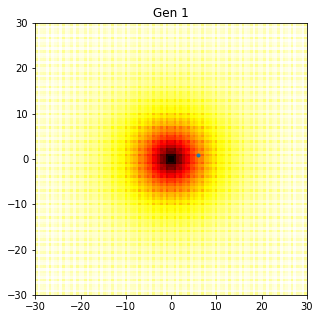

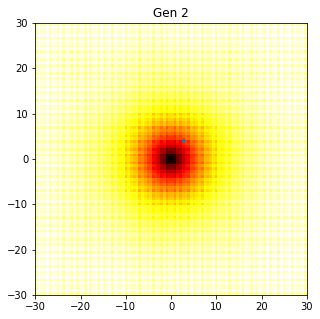

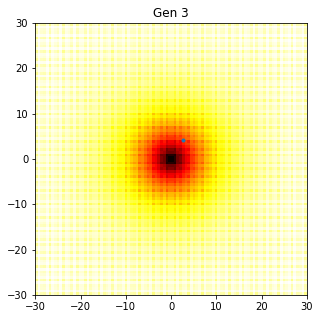

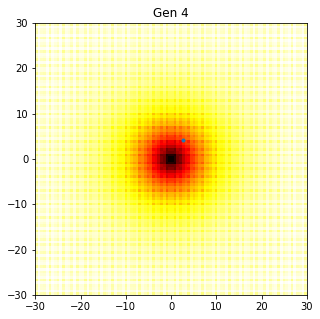

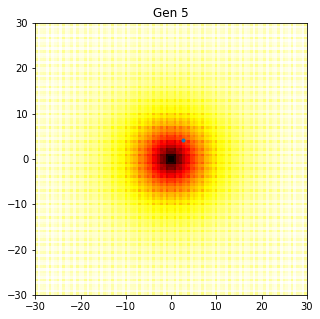

...

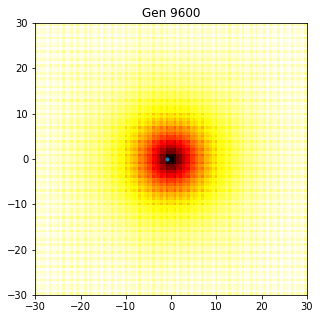

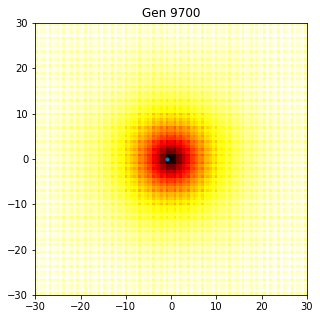

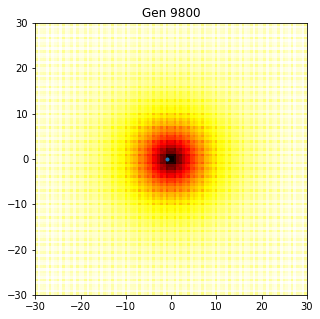

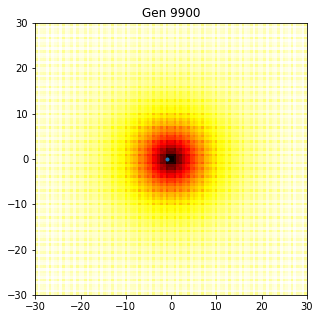

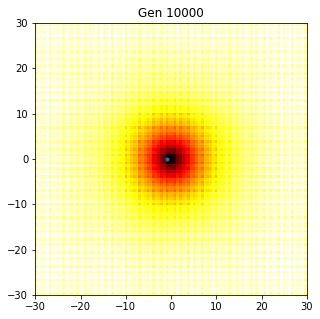

Best fit 2.579927557029869 at iteration 308


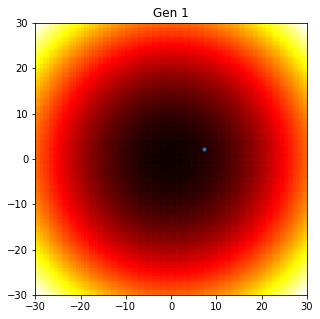

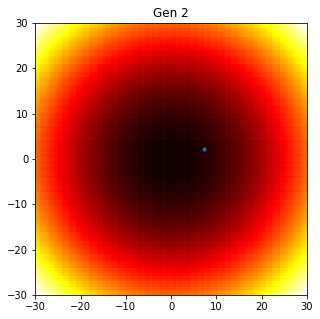

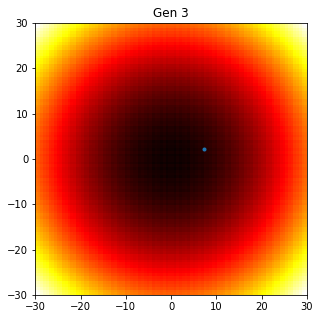

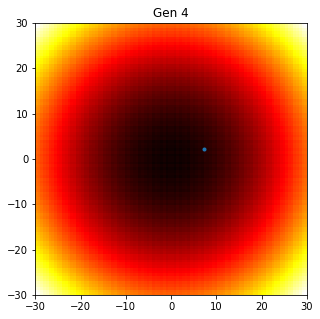

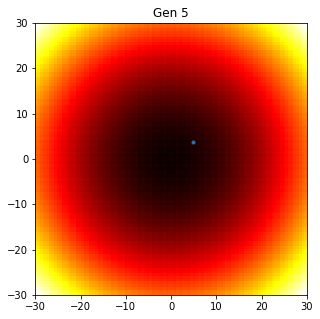

...

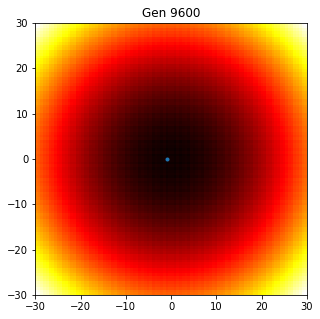

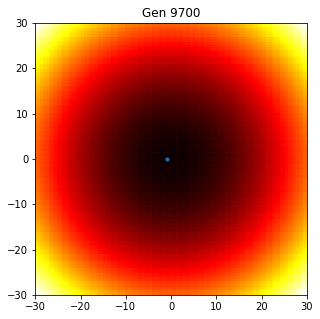

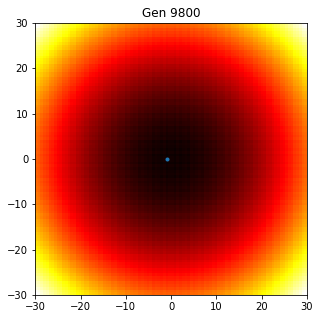

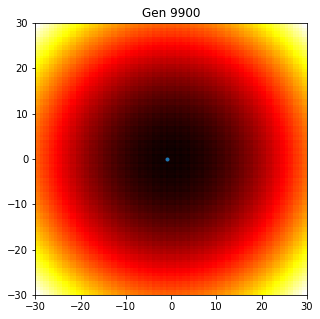

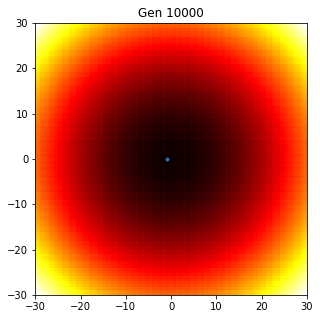

Best fit 0.9949590570932898 at iteration 298
Terminé.


In [42]:
dimensions = 2
sigma = 2
popInit = np.random.randint(-30,30, dimensions)
show = True
launch_ESonefifthRule(popInit, sigma=sigma, ma_func=sphere, display=show) 
launch_ESonefifthRule(popInit, sigma=sigma, ma_func=ackley, display=show) 
launch_ESonefifthRule(popInit, sigma=sigma, ma_func=rastrigin, display=show) 
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

## Regards sur l'éxecution considérée (sigma=0.5)

Sphere : Best fit 1.8219017813801677e-24 at iteration 7852

--> approche assez rapide vers la zone centrale ; trouve un meilleur Best Fit que les algorithmes précédents

Ackley : Best fit 14.01925567154503 at iteration 1188

--> reste coincé dans le maillage si point de départ trop loin du centre

Rastrigin : Best fit 72.63025687796147 at iteration 356

--> peut rester coincé dans le maillage

*

Dans les 3 cas --> Dépends trop du point de départ, même en changeant le sigma d'origine ; Reste vite coincé dans un optimum local si le maillage est trop large, le sigma baisse en cherchant un chemin de sortie puis devient trop faible pour permettre de sortir ; Choisir un sigma trop haut peut faire prendre le risque de sauter par dessus l'optimum global pour se retrouver coincer dans un local

---

# Exercice A-3: algorithme (mu,lambda)-ES

Vous testerez cette algorithme sur les mêmes fonction que précédemment. 

La méthode (*mu*,*lambda*) est une généralisation de la méthode (1+1) vue précédemment (qu'on peut noter aussi (*mu*=1 + *lambda*=1). Etant donnée une population d'individus, il s'agit de prendre les *mu* meilleurs, puis de créer *lambda* enfants. Chaque enfant aura pour parent l'un des *mu* parents (sélectionné au hasard). La population à la génération suivante sera constituée uniquement des *lambda* enfants ainsi construits (contrairement à la méthode (*mu*+*lambda*) ou les *mu* parents sont aussi copiés vers la génération suivante). 

Vous tracerez l'évolution de la population pour chaque exécution. Vous étudierez l'impact du choix du point initial et du sigma. 

Vous prendrez pour commencer *mu*=5 et *lambda*=10. Comme point de départ, vous utiliserez une population initiale de *lambda* invididus générés au hasard (plutôt qu'un seul individu, comme c'était le cas précédemment).


In [45]:
def launch_LambdaES(popInit, _mu, _lambda, sigma, nbeval=10000, display=True, ma_func=sphere):
    # A compléter
    i=0
    j=0     # (pourquoi un i ET un j, on pourrait utiliser un seul ?)

    parentsFit = np.apply_along_axis(ma_func, 1, popInit)   # calcul fitness
    argBest = np.argsort(parentsFit)[0:_mu]      # indice des mu meilleurs
    parents = popInit[argBest]      # initialisation des parents

    while i<nbeval:
        ind = np.random.choice(len(parents), size=_lambda)      # tirage des parents choisis (avec remise)
        childs = parents[ind] + sigma * np.random.normal( size=(_lambda,parents.shape[1]) )     # gaussian mutation (différente pour chaque enfant)
        childsFit = np.apply_along_axis(ma_func, 1, childs)     # calcul fitness child

        # maj de la population (calcul des nouveau parents)
        argBest = np.argsort(childsFit)[0:_mu]      # indice des mu meilleurs (plus petits)
        parents = np.copy(childs[argBest])      # choix des parents
        parentsFit = childsFit[argBest]       # récupération meilleures fitness

        j+=1
        solutions = np.copy(parents)
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1
    print ("Last fit",parentsFit)
    return parentsFit

print ("Terminé.")

Terminé.


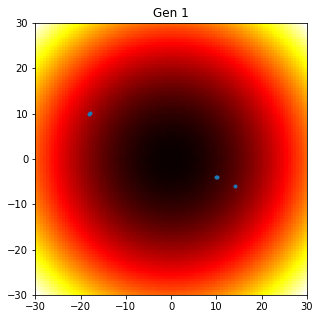

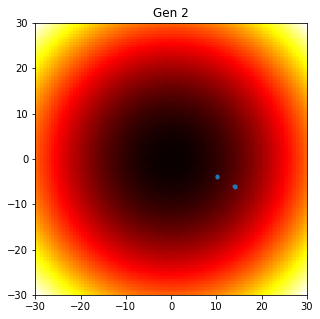

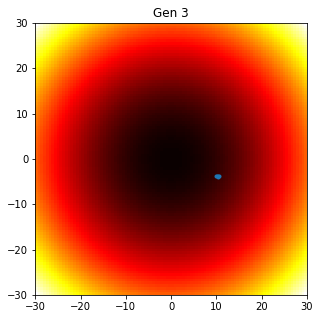

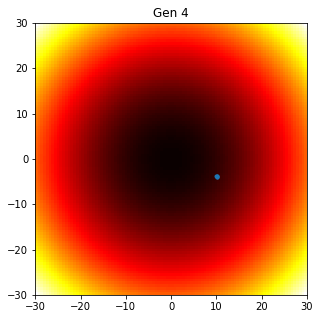

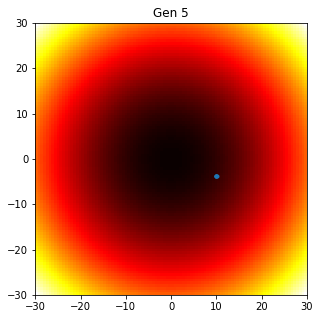

...

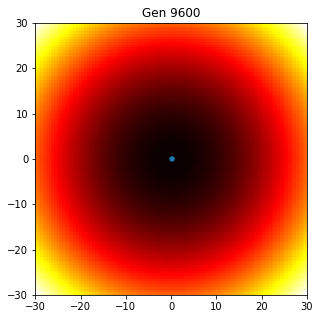

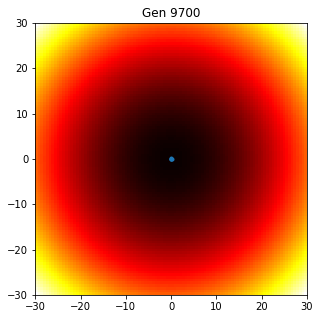

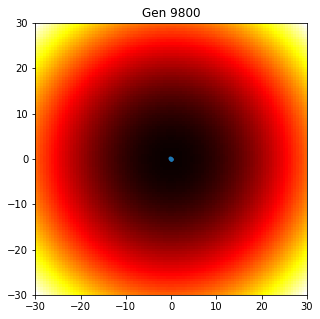

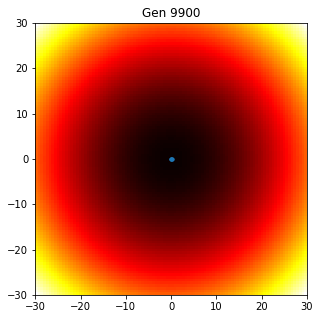

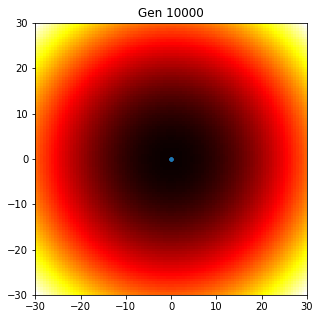

Last fit [0.00011789 0.00084909 0.00263375 0.01047368 0.01180935]


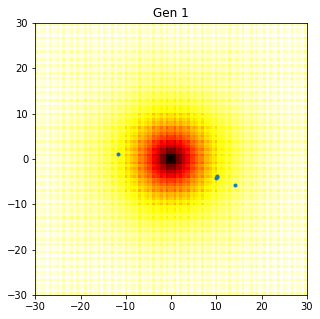

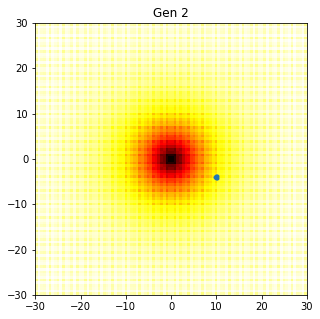

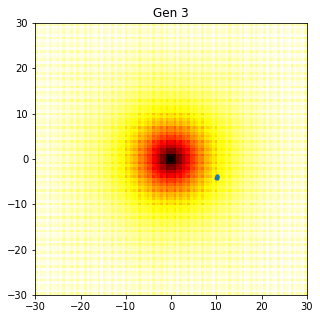

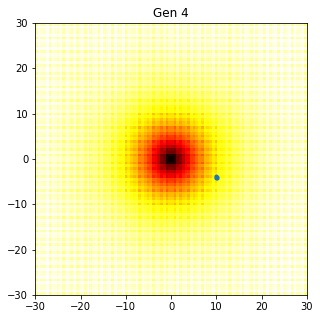

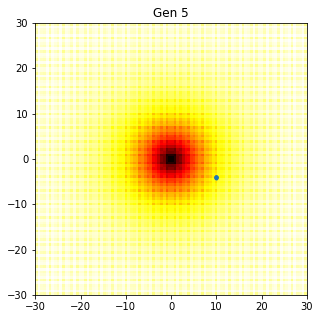

...

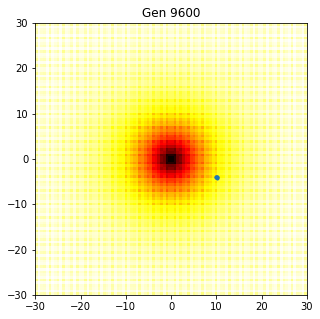

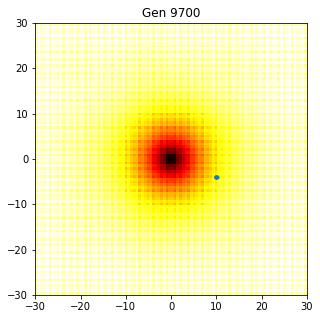

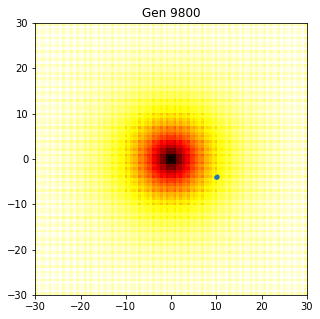

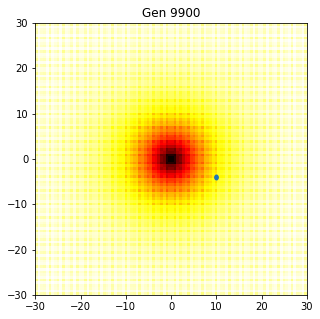

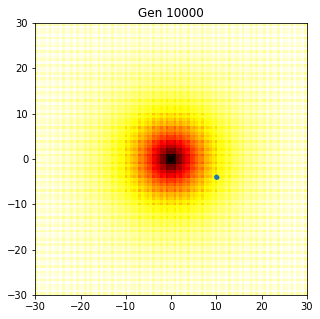

Last fit [15.6409697  15.69140768 15.78820197 15.94455244 16.07849977]


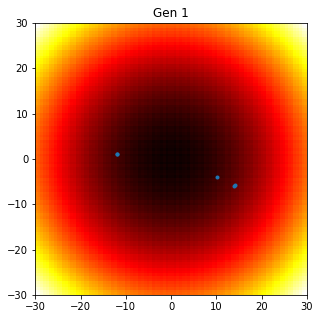

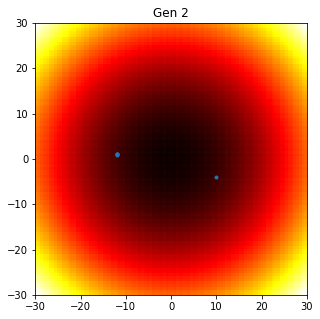

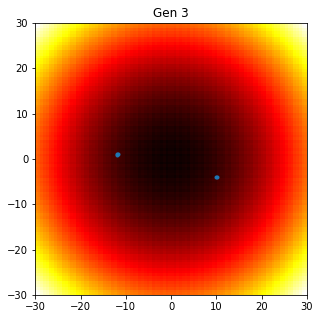

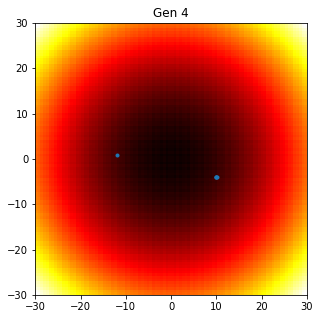

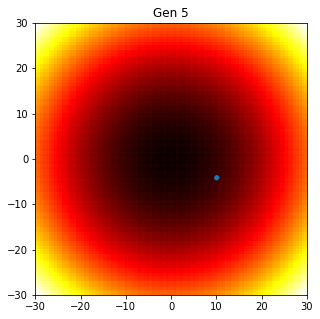

...

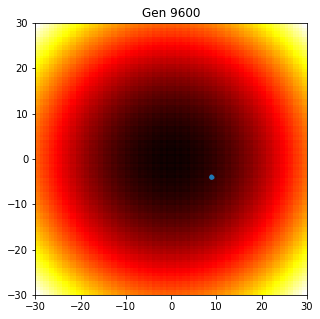

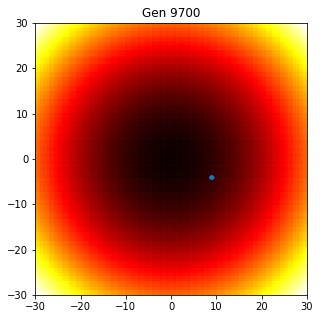

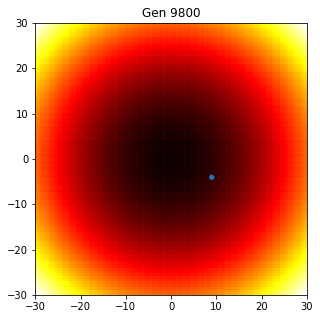

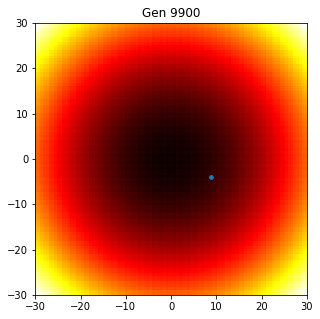

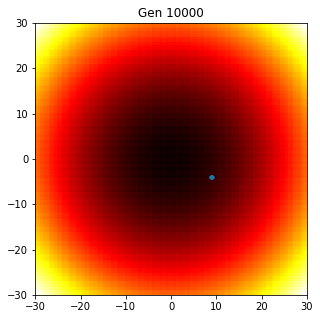

Last fit [ 97.29216244  98.30900041  99.03583489  99.22956529 100.00505316]
Terminé.


In [49]:
mu = 5
lmbda = 10
dimensions = 2
popInit = np.random.randint(-30,30, (lmbda,dimensions))
sigma = 0.1
show = True
launch_LambdaES(popInit, mu, lmbda, sigma, display=show, ma_func=sphere)
launch_LambdaES(popInit, mu, lmbda, sigma, display=show, ma_func=ackley)
launch_LambdaES(popInit, mu, lmbda, sigma, display=show, ma_func=rastrigin)
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

## Regards sur l'éxecution considérée (sigma=0.5)

Sphere : Last fit [0.05895442 0.08671386 0.13979683 0.24704507 0.42222508]

--> approche assez rapide vers la zone centrale

Ackley : Last fit [1.89750051 2.44908819 2.53713607 3.20419099 3.57552734]

--> reste dans la zone optimale

Rastrigin : Last fit [ 5.80653495 17.58706955 21.26342598 21.36882058 22.50156053]

--> maillage plus serré, difficulté à rester dans la zone optimale

*

Dans les 3 cas --> Un sigma grand permet de s'approcher plus rapidement de l'optimal, mais les points ont aussi plus de chance d'en sortir dans le cas d'un maillage. Comme précédemment, un sigma trop faible risque d'empêcher les points de sortir des optima locaux

---

# Exercice A-4: stabilité des algorithmes d'optimisation stochastique

Vous allez maintenant comparer l'aspect stochastique de ces algorithmes. Pour cela, observez le code ci-dessous, qui affiche le résultat de plusieurs exécutions du même algorithme de recherche aléatoire sous forme de violin graph. Utilisez la fonction Sphere, tester aussi avec la fonction Rastrigin. 


Best fit 864.6741705884033 at iteration 340
Best fit 875.2779381381333 at iteration 974
Best fit 800.3106161241799 at iteration 317
Best fit 775.8961752569809 at iteration 418
Best fit 694.8605664766295 at iteration 57
Best fit 787.4745781501506 at iteration 64
Best fit 778.1006151620468 at iteration 236
Best fit 762.1296058228997 at iteration 387
Best fit 811.2247539224276 at iteration 30
Best fit 873.8253272734855 at iteration 390
Best fit 604.9056994720048 at iteration 186
Best fit 728.4860118913798 at iteration 252
Best fit 886.4066928076511 at iteration 108
Best fit 724.1632863930951 at iteration 800
Best fit 595.4448319434468 at iteration 247
Best fit 900.8059646953205 at iteration 314
Best fit 813.1037046772836 at iteration 784
Best fit 561.9496383905687 at iteration 848
Best fit 752.6185551842477 at iteration 538
Best fit 714.9417028301707 at iteration 908
Best fit 841.9934325709144 at iteration 979
Best fit 930.5083657340396 at iteration 928
Best fit 805.4381475674827 at itera

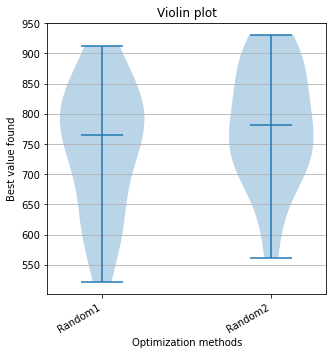

Terminé.


In [60]:
# fourni a titre d'exemple, ne pas modifier -- répondre dans la cellule suivante.

resRandom1 = []
resRandom2 = []

evaluationBudget = 1000
centerInit = [20]*16
evalFunc = sphere

for i in range(20):
    resRandom1.append ( launch_random(centerInit,nbeval=evaluationBudget,display=False,ma_func=evalFunc) )
    resRandom2.append ( launch_random(centerInit,nbeval=evaluationBudget,display=False,ma_func=evalFunc) )    
    
allResults = {"Random1":resRandom1,"Random2":resRandom2}

plot_violin( allResults )

print ("Terminé.")


Testez la robustesse des algorithmes (1+1)-ES simple et (1+1)-ES règle des 1/5e sur plusieurs exécutions sur ces deux fonctions. Vous pouvez ré-utiliser le code des cellules précédentes pour afficher le résultat de plusieurs exécutions de l'algorithme (ex.: 5 exécutions).

Best fit 0.00048590089902869897 at iteration 611
Best fit 0.0003448918638109648 at iteration 627
Best fit 7.360885573264395e-23 at iteration 831
Best fit 2.970971930505725e-23 at iteration 458
Best fit 0.9631632551853855 at iteration 930
Best fit 1.1089550501393646 at iteration 584
Best fit 49.74695183853324 at iteration 451
Best fit 1.9899181141865796 at iteration 347
Best fit 0.0004587597058226177 at iteration 249
Best fit 4.3064216065094506e-05 at iteration 302
Best fit 2.0931154741486885e-23 at iteration 695
Best fit 4.151729062410455e-24 at iteration 889
Best fit 0.0408271294295659 at iteration 714
Best fit 1.2059868496717847 at iteration 962
Best fit 323.3128072143091 at iteration 302
Best fit 0.9949590570932898 at iteration 340
Best fit 0.0007646442058575975 at iteration 807
Best fit 0.000103902260814677 at iteration 621
Best fit 4.006128240845853e-23 at iteration 519
Best fit 2.493958232034278e-23 at iteration 992
Best fit 0.05969314251522917 at iteration 543
Best fit 1.0009458

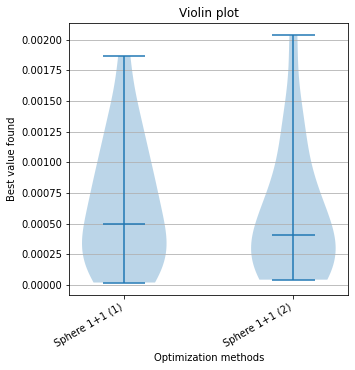

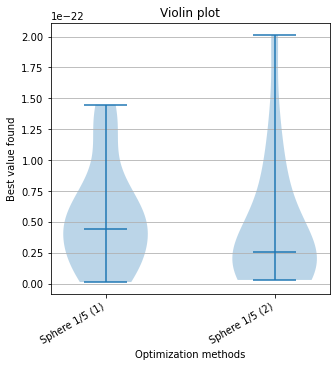

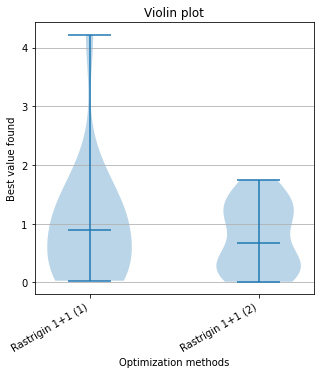

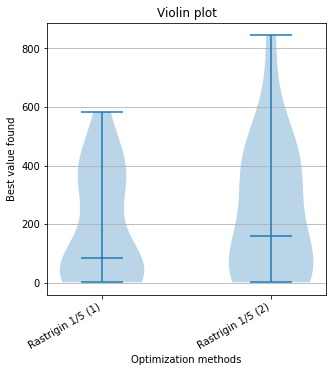

Terminé.


In [64]:
# A compléter
resRandom11 = []
resRandom12 = []
resRandom21 = []
resRandom22 = []
resRandom1r1 = []
resRandom1r2 = []
resRandom2r1 = []
resRandom2r2 = []


evaluationBudget = 1000

for i in range(20):
    centerInit = np.random.randint(-30,30, 2)
    resRandom11.append ( launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere) )
    resRandom12.append ( launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere) )
    resRandom21.append ( launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere) )
    resRandom22.append ( launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere) )     
    resRandom1r1.append ( launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=rastrigin) )
    resRandom1r2.append ( launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=rastrigin) )
    resRandom2r1.append ( launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=rastrigin) ) 
    resRandom2r2.append ( launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=rastrigin) ) 

allResults1 = {"Sphere 1+1 (1)":resRandom11,"Sphere 1+1 (2)":resRandom12}
allResults2 = {"Sphere 1/5 (1)":resRandom21,"Sphere 1/5 (2)":resRandom22}
allResultsr1 = {"Rastrigin 1+1 (1)":resRandom1r1,"Rastrigin 1+1 (2)":resRandom1r2}
allResultsr2 = {"Rastrigin 1/5 (1)" :resRandom2r1,"Rastrigin 1/5 (2)":resRandom2r2}

plot_violin(allResults1), plot_violin(allResults2), plot_violin(allResultsr1), plot_violin(allResultsr2)
print ("Terminé.")


_inclure ici quelques commentaires sur vos résultats_

Il est difficile de conclure sur uniquement 5 exécutions, les résultats semblent trop aléatoires. Cependant en regardant sur 20 exécutions, on constate un rapprochement des médianes et des formes des plot violins sur les mêmes méthodes.

# Exercice A-5: comparaison entre les algorithmes

 Vous allez maintenant comparer tous les algorithmes précédents en traçant les résultat sur une même figure. Sur la même figure, vous tracerez aussi les résultats de deux méthodes classiques d'optimisation: Nelder-Mead et Powell.  Vous pouvez tout écrire dans la cellule ci-dessous.

_Remarque: Pour que les comparaisons soient équitables, il faut que les points de départ des optimisation "classiques" soient similaires. Vous pourrez éventuellement ajouter un diagramme représentant le nombre d'évaluation par méthode._

Best fit 3.07755453157632e-23 at iteration 587
Best fit 1.3670516983371e-23 at iteration 949
Best fit 2.087327804566917e-23 at iteration 410
Best fit 1.9319638689813223e-23 at iteration 527
Best fit 5.618023990410134e-23 at iteration 498
Best fit 4.594992367774698e-23 at iteration 767
Best fit 6.345922677176641e-23 at iteration 796
Best fit 2.6798006535321584e-23 at iteration 560
Best fit 1.2289701354580012e-23 at iteration 919
Best fit 2.845016676400952e-23 at iteration 978
Best fit 2.0844905935186947e-24 at iteration 940
Best fit 2.4585317565824664e-23 at iteration 735
Best fit 1.8138280864610011e-22 at iteration 735
Best fit 1.6965555110801057e-23 at iteration 609
Best fit 1.64617190643624e-24 at iteration 770
Best fit 3.9276236860504763e-23 at iteration 544
Best fit 2.874738347325419e-23 at iteration 507
Best fit 1.2169569403205037e-24 at iteration 856
Best fit 1.9426443784240793e-23 at iteration 395
Best fit 4.281580839347151e-23 at iteration 881


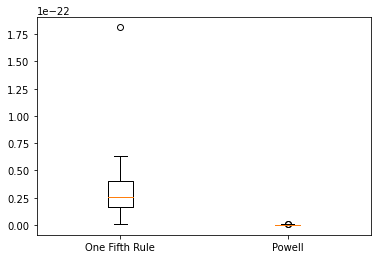

Terminé.


In [72]:
def launch_nelder(center, nbeval=10000, display=False, ma_func=sphere):
    nelder = minimize(ma_func, center, method='nelder-mead',options={'xtol': 1e-8, 'disp': display})
    return nelder.fun

def launch_powell(center, nbeval=10000, display=False, ma_func=sphere):
    powell = minimize(ma_func, center, method='powell',options={'xtol': 1e-8, 'disp': display})
    return powell.fun

resOneplusone = []
resRandom = []
resOneFifthRule = []
resNelder = []
resPowell = []

# A compléter
evaluationBudget = 1000
x = []
labels = []

for i in range(20):
  centerInit = np.random.randint(-30,30, 2)
  #resOneplusone.append(launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere))
  #resRandom.append(launch_random(centerInit,nbeval=evaluationBudget,display=False,ma_func=evalFunc))
  resOneFifthRule.append(launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere))
  #resNelder.append(launch_nelder(centerInit, nbeval=evaluationBudget, display=False, ma_func=sphere))
  resPowell.append(launch_powell(centerInit, nbeval=evaluationBudget, display=False, ma_func=sphere))

#x.append(resOneplusone), labels.append("One plus one")
#x.append(resRandom), labels.append("Random")
x.append(resOneFifthRule), labels.append("One Fifth Rule")
#x.append(resNelder), labels.append("Nelder")
x.append(resPowell), labels.append("Powell")
plt.boxplot(x,labels=labels)
plt.show()

print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

## Ordre constaté (du moins bon au meilleur, sigma = 0.5)

Random : Best Fit beaucoup plus grands et étalés

1+1

Nelder

1+1 (1/5 rules)

Powell

---

# Exercice A-6: algorithme CEM

Nous allons maintenant implémenter l'algorithme Cross Entropy Method (CEM)

Vous utiliserez pour cela l'algorithme tel qu'il a présenté en cours (cf. slides), et le pseudo-code disponible sur [wikipedia](https://fr.wikipedia.org/wiki/M%C3%A9thode_de_l%27entropie_crois%C3%A9e#Pseudo-code)

Vous testerez cet algorithme sur les mêmes fonctions que précédemment. De même que précédemment, vous tracerez l'évolution de la population pour chaque exécution. 

Vous étudierez l'impact du choix du point initial et du sigma. Vous comparerez également la version complète avec la version pureCMA, qui n'inclut pas certains mécanismes comme le restart. 

In [96]:
def launch_CEM(center, sigma, nbeval=10000, display=True, ma_func=sphere):
    # A compléter
    N = 100   # arbitraire
    nbBest = 10   # arbitraire

    mu = np.copy(center)
    taille = len(mu)
    sigma2 = np.copy(sigma)
    sigmaMAx = [1]*taille

    i=0
    j=0

    while i<nbeval:
        X = np.random.normal(mu, sigma2, size=(N,taille))    # tirage de N points
        X_fit = np.apply_along_axis(ma_func, 1, X)   # calcul fitness

        argBest = np.argsort(X_fit)[0:nbBest+1]     # récupère les 1+nbBest meilleures solutions (plus petites)
        S_rho = X[argBest]      # stocke les meilleures dans S_rho
        S_rho_Fit = X_fit[argBest]

        # recalcul des mu et sigma2
        mu = np.mean(S_rho,0)
        sigma2 = np.minimum(np.var(S_rho,0) + sigma, [2,2])   # ne dépasse pas une variance de [2,2]

        j+=1
        solutions = np.copy(S_rho)
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1

    print ("Last fit",S_rho_Fit)
    return S_rho_Fit[0]

print ("Terminé.")

Terminé.


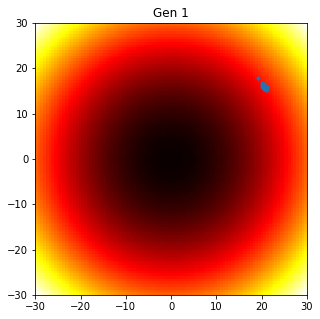

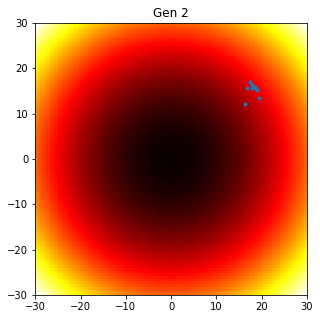

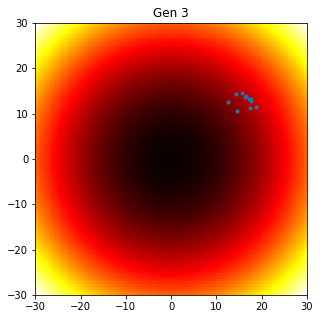

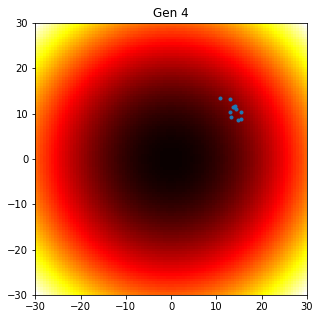

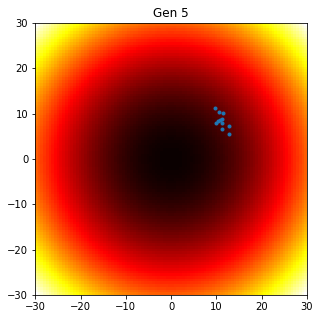

...

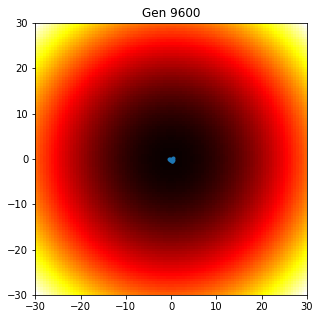

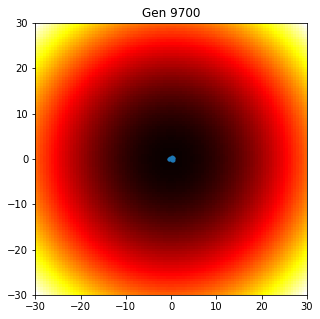

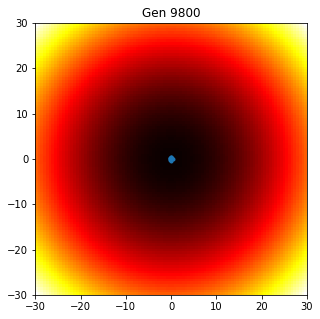

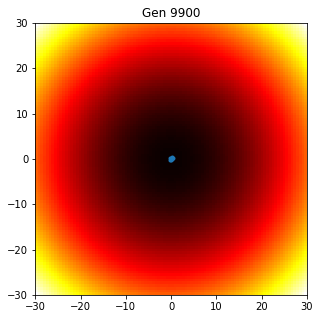

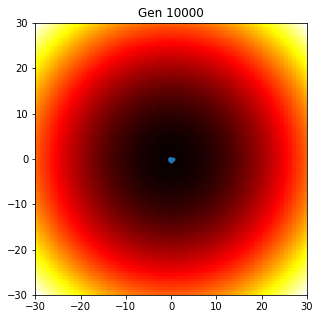

Last fit [0.00658827 0.05233031 0.06818974 0.07992785 0.08793096 0.09160481
 0.09274245 0.11685643 0.12540417 0.13200325 0.1544721 ]


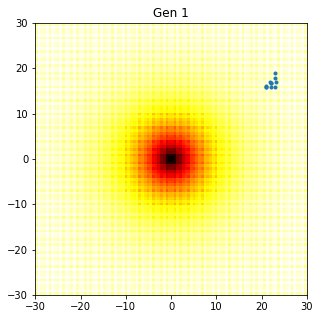

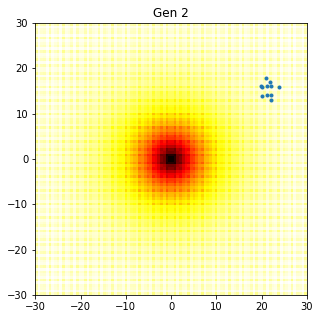

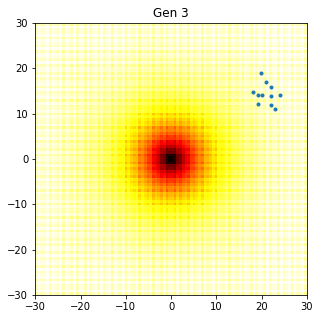

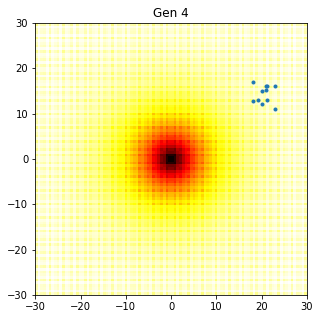

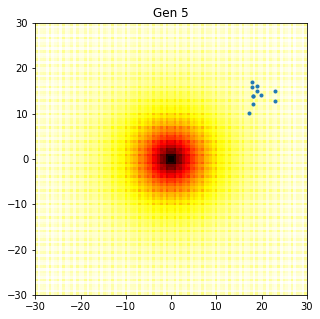

...

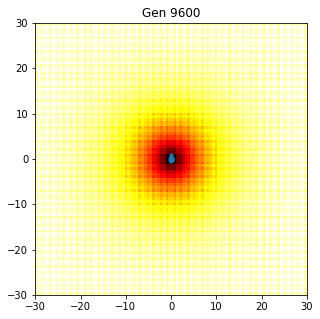

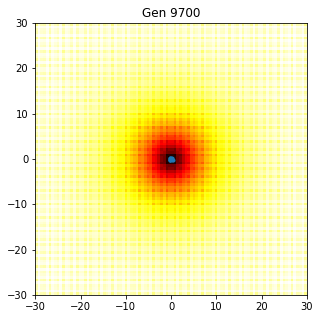

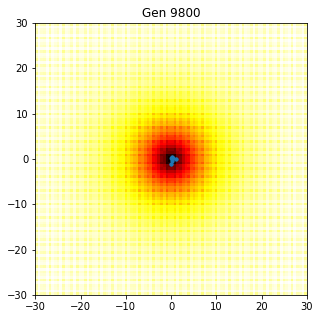

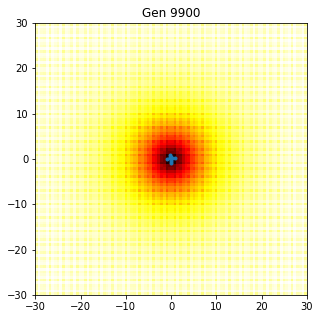

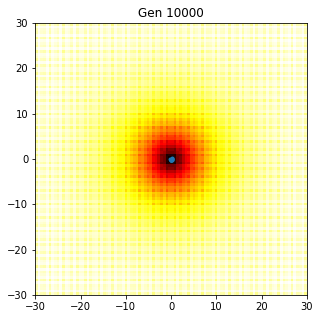

Last fit [0.47876116 1.03578475 1.07236089 1.28651059 1.42927707 1.75104264
 1.81319429 1.81653526 1.87162084 2.11712607 2.1291792 ]


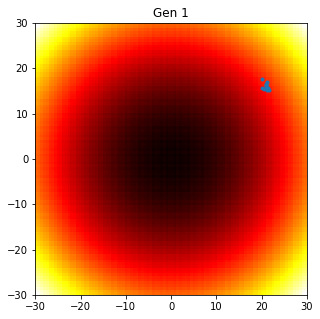

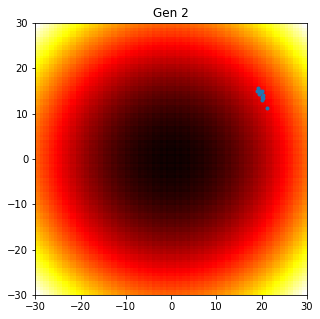

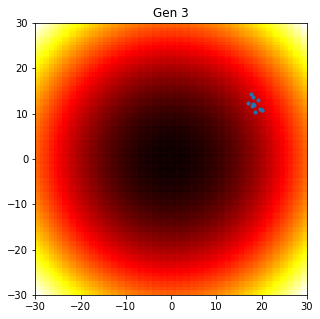

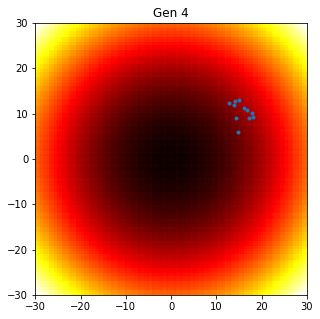

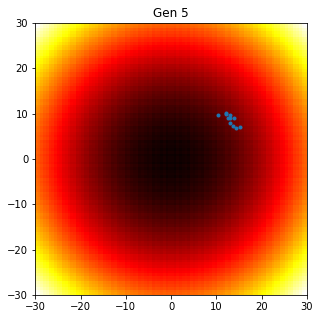

...

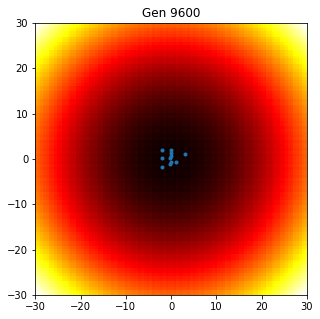

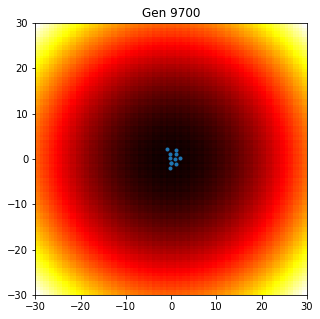

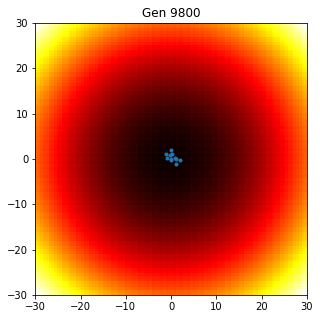

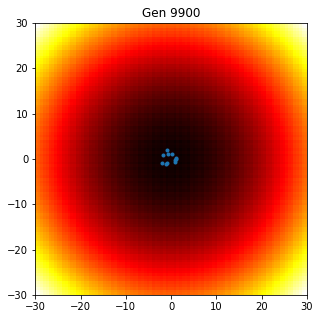

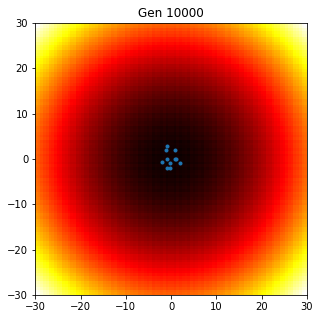

Last fit [ 2.89544546  4.05455946  5.31786857  6.12092633  6.63247753  6.88371815
  9.32511784 11.24162711 11.47696841 12.5171109  12.71072815]
Terminé.


In [78]:
dimensions = 2
center = np.random.randint(-30,30, 2)
sigma = [0.9]*dimensions

show = True
launch_CEM(center, sigma, display=show, ma_func=sphere)
launch_CEM(center, sigma, display=show, ma_func=ackley)
launch_CEM(center, sigma, display=show, ma_func=rastrigin)
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

**Regards sur l'éxecution considérée (sigma=0.5)**

Sphere : Last fit [0.00249277 0.00343122 0.00751631 0.01168756 0.03417204 0.05371607 0.05708992 0.06549653 0.07730086 0.08923086 0.09261601]

--> approche rapide vers la zone centrale, regroupement des points autour de l'optimum

Ackley : Last fit [0.16873823 0.33870608 0.4614536  0.53102448 0.91803994 1.00823147 1.13389884 1.17055807 1.32046503 2.1482018  2.20927706]

--> reste dans la zone optimale

Rastrigin : Last fit [1.81225193 2.89892803 3.95679742 4.13633553 4.25811515 4.96795905 5.76388406 6.49443156 7.64706638 7.94739032 8.10963744]

--> maillage plus serré, difficulté à rester dans la zone optimale

*

Dans les 3 cas --> Possibilité de divergence si on démarre sur un plateau, sigma devient alors trop grand. Solution, on pose une valeur maximale à sigma pour empcher la divergence ; Un sigma trop petit empêche de se déplacer suffisement loin pour se rapprocher du centre, si le maillage n'est pas assez serré. À l'inverse un sigma trop grand permet de se déplacer à la recherche d'un optimum plus librement, mais empêche de correctement se stabiliser une fois la zone optimale trouvée

Reprenez l'exercice 5 pour ajouter CEM sur le graphe.

Best fit 0.00017105492441248847 at iteration 631
Best fit 3.186992014402489e-23 at iteration 941


<ipython-input-79-96a756d254f9>:2: OptimizeWarning: Unknown solver options: xtol
  nelder = minimize(ma_func, center, method='nelder-mead',options={'xtol': 1e-8, 'disp': display})


Last fit [0.01399718 0.02008736 0.02421246 0.03155535 0.0422956  0.05078763
 0.05291355 0.06339724 0.06380985 0.06647079 0.08306515]
Best fit 0.0003592820207175575 at iteration 481
Best fit 3.185713431596757e-23 at iteration 741
Last fit [0.00989565 0.02037991 0.02276789 0.02364957 0.02867365 0.03881228
 0.04462502 0.07340892 0.07745373 0.08138048 0.08571749]
Best fit 0.0010338865801727977 at iteration 476
Best fit 3.615636179638833e-23 at iteration 874
Last fit [0.01070273 0.01348058 0.0240277  0.03464477 0.04795812 0.04908272
 0.04945676 0.05690731 0.05876078 0.06427599 0.07804169]
Best fit 0.0006361493177796234 at iteration 136
Best fit 2.375001260629982e-24 at iteration 675
Last fit [0.00181439 0.00908473 0.01201541 0.01239683 0.01398026 0.02354426
 0.0507499  0.05122149 0.05599639 0.06680685 0.06719602]
Best fit 0.0005523873908881362 at iteration 507
Best fit 4.313425200626872e-23 at iteration 552
Last fit [0.00229623 0.00506096 0.01215036 0.01377342 0.02004335 0.02059307
 0.02384

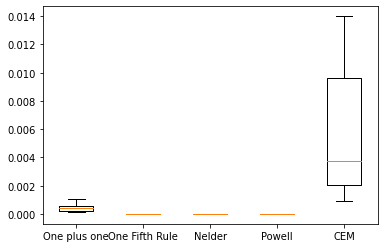

Terminé.


In [79]:
def launch_nelder(center, nbeval=10000, display=False, ma_func=sphere):
    nelder = minimize(ma_func, center, method='nelder-mead',options={'xtol': 1e-8, 'disp': display})
    return nelder.fun

def launch_powell(center, nbeval=10000, display=False, ma_func=sphere):
    powell = minimize(ma_func, center, method='powell',options={'xtol': 1e-8, 'disp': display})
    return powell.fun

resCEM = []
resOneplusone = []
resRandom = []
resOneFifthRule = []
resNelder = []
resPowell = []

# A compléter
x = []
labels = []

for i in range(10):
  centerInit = np.random.randint(-30,30, 2)
  resOneplusone.append(launch_oneplusone(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere))
  #resRandom.append(launch_random(centerInit,nbeval=evaluationBudget,display=False,ma_func=evalFunc))
  resOneFifthRule.append(launch_ESonefifthRule(centerInit,sigma=0.5,nbeval=evaluationBudget,display=False,ma_func=sphere))
  resNelder.append(launch_nelder(centerInit, nbeval=evaluationBudget, display=False, ma_func=sphere))
  resPowell.append(launch_powell(centerInit, nbeval=evaluationBudget, display=False, ma_func=sphere))
  resCEM.append( launch_CEM(centerInit, [0.5,0.5], nbeval=evaluationBudget, display=False, ma_func=sphere) )

x.append(resOneplusone), labels.append("One plus one")
#x.append(resRandom), labels.append("Random")
x.append(resOneFifthRule), labels.append("One Fifth Rule")
x.append(resNelder), labels.append("Nelder")
x.append(resPowell), labels.append("Powell")
x.append(resCEM), labels.append("CEM")
plt.boxplot(x,labels=labels)
plt.show()

print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

L'algorithme CEM semble se positionner en terme d'éfficacité entre l'algorithme de marche aléatoire, et celui du 1+1 classique.

Modifiez CEM pour que l'amplitude de la mutation (i.e. *sigma*) diminue au cours du temps. La vitesse à laquelle diminue ce taux est fixe. Cela permet d'éviter le bruit dû à la mutation qui peu géner la conférence en fin d'optimisation.

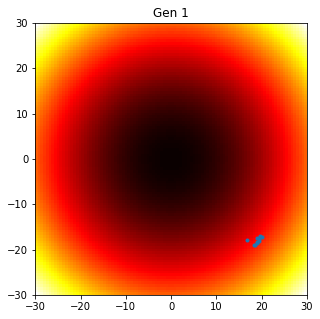

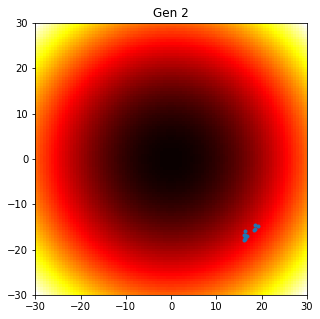

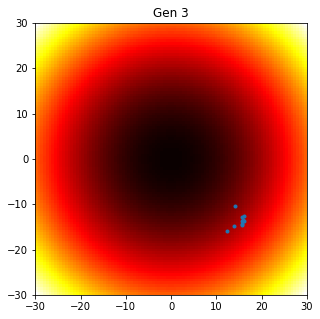

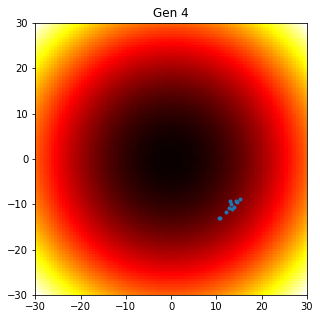

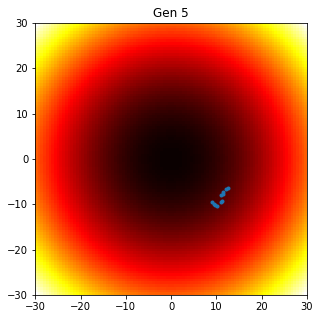

...

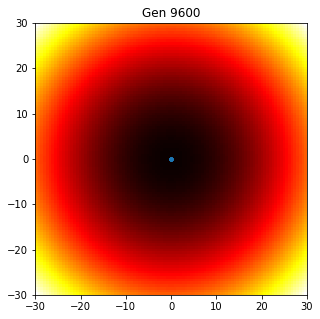

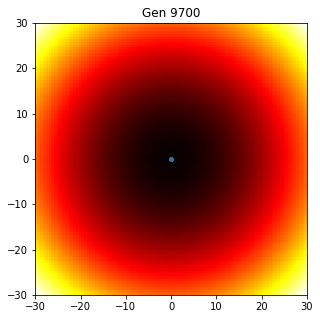

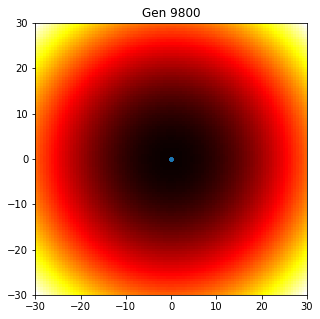

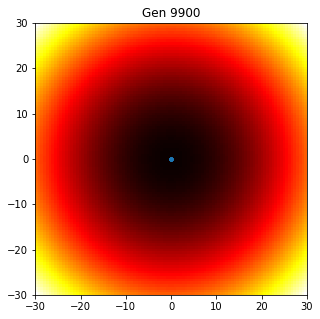

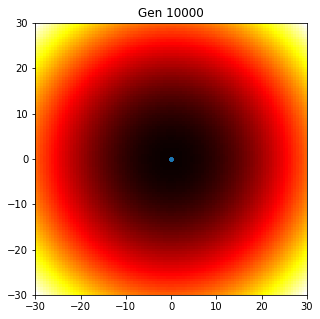

Last fit [5.35735007e-10 2.71539126e-09 5.70881788e-09 5.92265498e-09
 7.79179233e-09 7.99353618e-09 8.27486718e-09 8.31784810e-09
 1.00015909e-08 1.05671314e-08 1.07594248e-08]


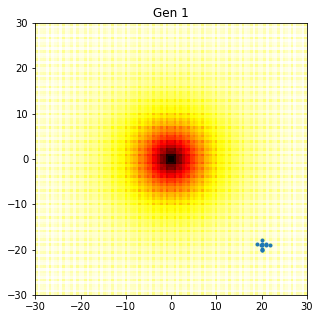

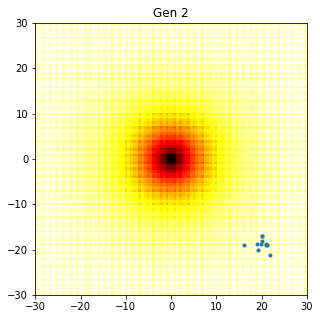

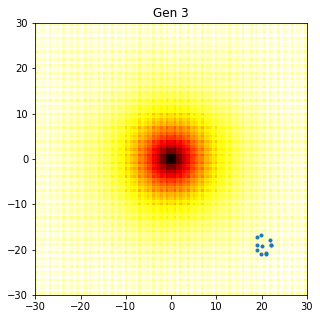

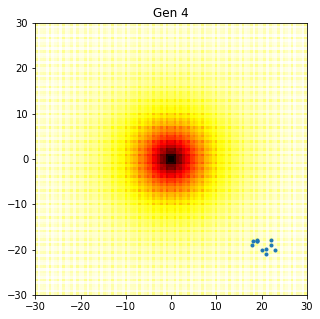

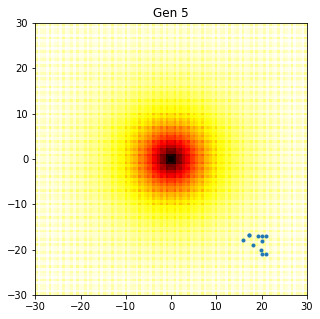

...

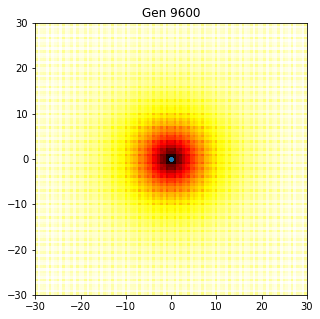

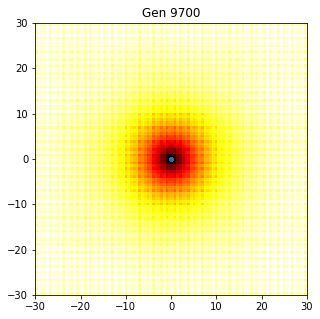

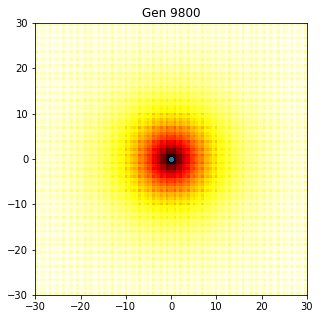

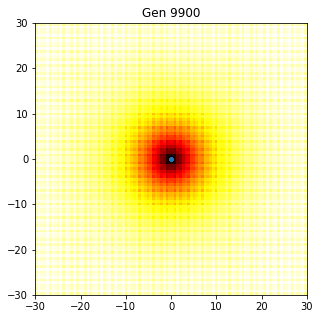

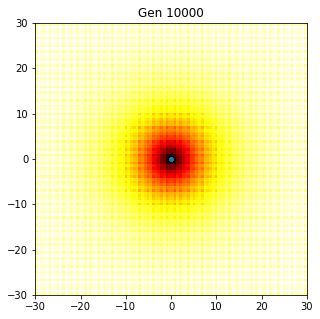

Last fit [8.53674949e-05 1.36174504e-04 1.36850341e-04 1.43460794e-04
 2.12148026e-04 2.22947326e-04 2.52296594e-04 2.54565798e-04
 2.56063503e-04 2.90371080e-04 2.93469295e-04]


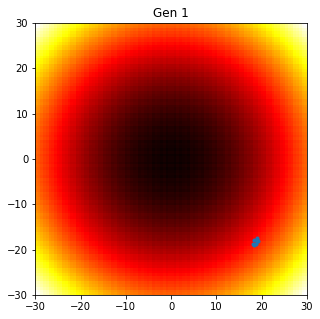

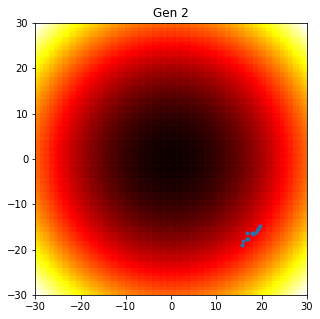

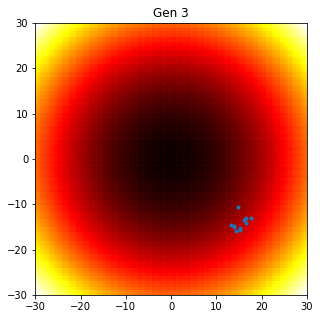

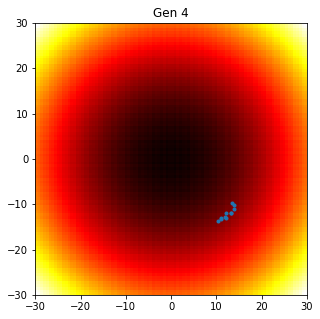

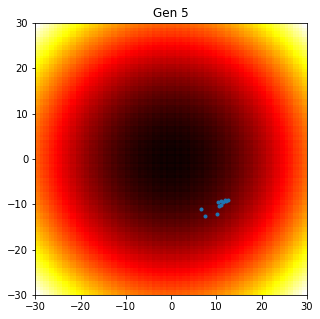

...

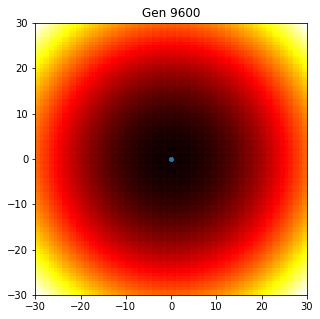

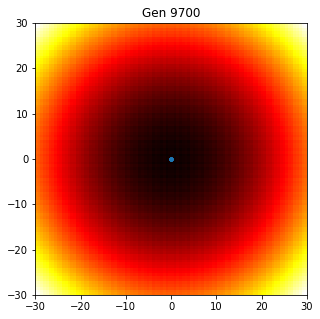

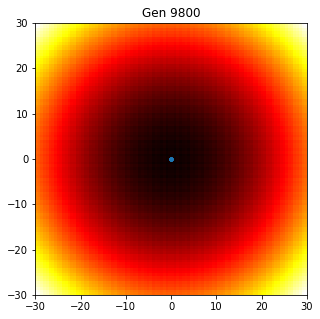

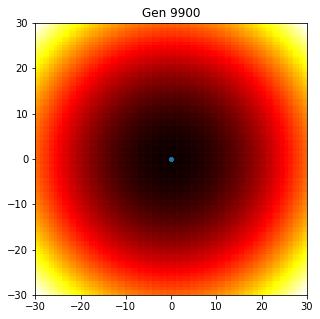

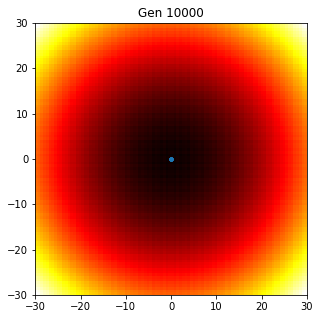

Last fit [5.81415804e-08 4.27607084e-07 4.69928501e-07 5.03734615e-07
 5.21877908e-07 7.50328496e-07 7.53641409e-07 1.08526091e-06
 1.26532073e-06 1.31900328e-06 1.58828652e-06]
Terminé.


In [91]:
# à compléter
def launch_CEM2(center, sigma, nbeval=10000, display=True, ma_func=sphere):
    # A compléter
    N = 100   # arbitraire
    nbBest = 10   # arbitraire

    mu = np.copy(center)
    taille = len(mu)
    sigma2 = np.copy(sigma)
    sigmaMAx = [2]*taille
    diminution = [sigma[k]/nbeval for k in range(taille)]
    
    i=0
    j=0

    while i<nbeval:
        X = np.random.normal(mu, sigma2, size=(N,taille))    # tirage de N points
        X_fit = np.apply_along_axis(ma_func, 1, X)   # calcul fitness

        argBest = np.argsort(X_fit)[0:nbBest+1]     # récupère les 1+nbBest meilleures solutions (plus petites)
        S_rho = X[argBest]      # stocke les meilleures dans S_rho
        S_rho_Fit = X_fit[argBest]

        # recalcul des mu et sigma2
        mu = np.mean(S_rho,0)
        sigma2 = np.minimum(np.var(S_rho,0) + sigma, sigmaMAx)   # ne dépasse pas une variance de [2,2]
        sigma = [sigma[k]-diminution[k] for k in range(taille)]

        j+=1
        solutions = np.copy(S_rho)
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j)) # on projette uniquement sur les deux premières dimensions.
        i+=1

    print ("Last fit",S_rho_Fit)
    return S_rho_Fit[0]



dimensions = 2
center = np.random.randint(-30,30, 2)
sigma = [0.9]*dimensions

show = True
launch_CEM2(center, sigma, display=show, ma_func=sphere)
launch_CEM2(center, sigma, display=show, ma_func=ackley)
launch_CEM2(center, sigma, display=show, ma_func=rastrigin)
print ("Terminé.")

_inclure ici quelques commentaires sur vos résultats_

Permet ainsi de démarrer avec un sigma large pour chercher vite à se rapprocher de la zone optimale. La décroissance de la mutation aide le groupement de points à se stabiliser autour du l'optimum une fois arrivé suffisement proche et après un grand nombre d'itération. On est ainsi beaucoup moins dépendant du point de départ.

---
---
---

# <font color='orange'>PARTIE B: optimisation d'un pendule inversé</font>

OpenAI Gym (https://gym.openai.com/) est un framework permettant de lancer facilement des expériences d'apprentissage par renforcement. Nous allons l'utiliser pour tester les algorithmes évolutionnistes. Pour cet exercice, vous êtes laissé en autonomie: vous devez donc lire attentivement la documentation et les exemples.

# Importation des librairies et définition des fonctions utiles pour la partie B

Remarque: *Il est nécessaire d'exécuter ces cellules une seule fois. En cas de redémarrage du noyau, il faut relancer ces cellules. Il n'est pas nécessaire de regarder le code de ces cellules, elles servent seulement de soutien à la partie B.*

In [7]:
# source: https://colab.research.google.com/drive/124koV4mf1tQdépart4av9jAJJuWsyuhJyLyd70#scrollTo=G9UWeToN4r7D

#remove " > /dev/null 2>&1" to see what is going on under the hood
!pip install pyvirtualdisplay > /dev/null 2>&1
!apt-get install -y xvfb python-opengl ffmpeg > /dev/null 2>&1
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1400, 900))
display.start()

!apt-get update > /dev/null 2>&1
!apt-get install cmake > /dev/null 2>&1
!pip install --upgrade setuptools 2>&1
!pip install ez_setup > /dev/null 2>&1
!pip install gym[atari] > /dev/null 2>&1

!pip install gym[classic_control] > /dev/null 2>&1 
# for pygame

from datetime import datetime
from datetime import date

import base64
import glob
import io
import base64
from IPython.display import HTML
from IPython import display as ipythondisplay

import gym
from gym import logger as gymlogger
# from gym.wrappers import Monitor # deprecated 2023 - https://stackoverflow.com/questions/71520568/importerror-cannot-import-name-monitor-from-gym-wrappers
from gym.wrappers.record_video import RecordVideo
gymlogger.set_level(40) #error only
import tensorflow as tf
import numpy as np
import random
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import math
import glob
import io
import base64
from IPython.display import HTML

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

 2023-03-16 21:57:55 GMT
OK.


In [8]:
# source: https://colab.research.google.com/drive/124koV4mf1tQ4av9jAJJuWsyuhJyLyd70#scrollTo=G9UWeToN4r7D
# modification mineur: ajout de l'argument loop dans la fonction show_video(loop=True)

"""
Utility functions to enable video recording of gym environment and displaying it
To enable video, just do "env = wrap_env(env)""
"""

def show_video(loop=True):
  mp4list = glob.glob('video/*.mp4')
  if len(mp4list) > 0:
    mp4 = mp4list[0]
    video = io.open(mp4, 'r+b').read()
    encoded = base64.b64encode(video)
    if loop == True:
      ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
    else:
      ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
  else: 
    print("Could not find video")
    
def wrap_env(env):
  env = RecordVideo(env, './video',  episode_trigger = lambda episode_number: True) # !!! 2023
  env.reset() # !!! 2023
  #env = Monitor(env, './video', force=True)
  return env

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:57:55 GMT
OK.


In [9]:
# A simple neural network object
# source: https://github.com/AsmaBRZ/Evolutionary-algorithms/blob/master/fixed_structure_nn_numpy.py

# coding: utf-8

import numpy as np

## Suppress TF info messages

import os

def sigmoid(x):
    return 1./(1 + np.exp(-x))

def tanh(x):
    return np.tanh(x)


def gen_simplemlp(n_in, n_out, n_hidden_layers=2, n_neurons_per_hidden=5):
    n_neurons = [n_neurons_per_hidden]*n_hidden_layers if np.isscalar(n_neurons_per_hidden) else n_neurons_per_hidden
    i = Input(shape=(n_in,))
    x = i
    for n in n_neurons:
        x = Dense(n, activation='sigmoid')(x)
    o = Dense(n_out, activation='tanh')(x)
    m = Model(inputs=i, outputs=o)
    return m
    

class SimpleNeuralControllerNumpy():
    def __init__(self, n_in, n_out, n_hidden_layers=2, n_neurons_per_hidden=5, params=None):
        self.dim_in = n_in
        self.dim_out = n_out
        # if params is provided, we look for the number of hidden layers and neuron per layer into that parameter (a dicttionary)
        if (not params==None):
            if ("n_hidden_layers" in params.keys()):
                n_hidden_layers=params["n_hidden_layers"]
            if ("n_neurons_per_hidden" in params.keys()):
                n_neurons_per_hidden=params["n_neurons_per_hidden"]
        self.n_per_hidden = n_neurons_per_hidden
        self.n_hidden_layers = n_hidden_layers
        self.weights = None 
        self.n_weights = None
        self.init_random_params()
        self.out = np.zeros(n_out)
        #print("Creating a simple mlp with %d inputs, %d outputs, %d hidden layers and %d neurons per layer"%(n_in, n_out,n_hidden_layers, n_neurons_per_hidden))

    
    def init_random_params(self):
        if(self.n_hidden_layers > 0):
            self.weights = [np.random.random((self.dim_in,self.n_per_hidden))] # In -> first hidden
            self.bias = [np.random.random(self.n_per_hidden)] # In -> first hidden
            for i in range(self.n_hidden_layers-1): # Hidden -> hidden
                self.weights.append(np.random.random((self.n_per_hidden,self.n_per_hidden)))
                self.bias.append(np.random.random(self.n_per_hidden))
            self.weights.append(np.random.random((self.n_per_hidden,self.dim_out))) # -> last hidden -> out
            self.bias.append(np.random.random(self.dim_out))
        else:
            self.weights = [np.random.random((self.dim_in,self.dim_out))] # Single-layer perceptron
            self.bias = [np.random.random(self.dim_out)]
        self.n_weights = np.sum([np.product(w.shape) for w in self.weights]) + np.sum([np.product(b.shape) for b in self.bias])

    def get_parameters(self):
        """
        Returns all network parameters as a single array
        """
        flat_weights = np.hstack([arr.flatten() for arr in (self.weights+self.bias)])
        return flat_weights

    def set_parameters(self, flat_parameters):
        """
        Set all network parameters from a single array
        """
        i = 0 # index
        to_set = []
        self.weights = list()
        self.bias = list()
        if(self.n_hidden_layers > 0):
            # In -> first hidden
            w0 = np.array(flat_parameters[i:(i+self.dim_in*self.n_per_hidden)])
            self.weights.append(w0.reshape(self.dim_in,self.n_per_hidden))
            i += self.dim_in*self.n_per_hidden
            for l in range(self.n_hidden_layers-1): # Hidden -> hidden
                w = np.array(flat_parameters[i:(i+self.n_per_hidden*self.n_per_hidden)])
                self.weights.append(w.reshape((self.n_per_hidden,self.n_per_hidden)))
                i += self.n_per_hidden*self.n_per_hidden
            # -> last hidden -> out
            wN = np.array(flat_parameters[i:(i+self.n_per_hidden*self.dim_out)])
            self.weights.append(wN.reshape((self.n_per_hidden,self.dim_out)))
            i += self.n_per_hidden*self.dim_out
            # Samefor bias now
            # In -> first hidden
            b0 = np.array(flat_parameters[i:(i+self.n_per_hidden)])
            self.bias.append(b0)
            i += self.n_per_hidden
            for l in range(self.n_hidden_layers-1): # Hidden -> hidden
                b = np.array(flat_parameters[i:(i+self.n_per_hidden)])
                self.bias.append(b)
                i += self.n_per_hidden
            # -> last hidden -> out
            bN = np.array(flat_parameters[i:(i+self.dim_out)])
            self.bias.append(bN)
            i += self.dim_out
        else:
            n_w = self.dim_in*self.dim_out
            w = np.array(flat_parameters[:n_w])
            self.weights = [w.reshape((self.dim_in,self.dim_out))]
            self.bias = [np.array(flat_parameters[n_w:])]
        self.n_weights = np.sum([np.product(w.shape) for w in self.weights]) + np.sum([np.product(b.shape) for b in self.bias])
    
    def predict(self,x):
        """
        Propagate
        """
        if(self.n_hidden_layers > 0):
            #Input
            a = np.matmul(x,self.weights[0]) + self.bias[0]
            y = sigmoid(a)
            # hidden -> hidden
            for i in range(1,self.n_hidden_layers-1):
                a = np.matmul(y, self.weights[i]) + self.bias[i]
                y = sigmoid(a)
            # Out
            a = np.matmul(y, self.weights[-1]) + self.bias[-1]
            out = tanh(a)
            return out
        else: # Simple monolayer perceptron
            return tanh(np.matmul(x,self.weights[0]) + self.bias[0])

    def __call__(self,x):
        """Calling the controller calls predict"""
        return self.predict(x)

print("\n",date.today(), datetime.now().strftime("%H:%M:%S"),"GMT") # timestamp is greenwich time
print("OK.")


 2023-03-16 21:57:55 GMT
OK.


---

# Question B-0: simulation du pendule inversé

Le code ci-dessous montre comment lancer la simulation d'un pendule inversé en utilisant OpenAI Gym. Etudiez-le et exécutez-le.



In [10]:
import gym
#env = gym.make('CartPole-v1')
env = wrap_env( gym.make('CartPole-v1') ) # colab-specific # needs py-game (import in earlier cell)

observation = env.reset()

#for _ in range(1000):
#while True:
maxEvaluations = 50
evaluation = 0
while evaluation < maxEvaluations:
    env.render()
    action = env.action_space.sample() 
    observation, reward, done, info = env.step(action) 

    if done:
      evaluation = evaluation + 1
      observation = env.reset()
      print ("obs:",observation,type(observation),observation.shape)
      #show_video(False) # colab-specific

env.close()

show_video() # colab-specific

obs: [-0.02459063 -0.02615766  0.01137187  0.02638298] <class 'numpy.ndarray'> (4,)
obs: [-0.02518189 -0.03380615  0.03794932 -0.04173988] <class 'numpy.ndarray'> (4,)
obs: [-0.03145622  0.01866144 -0.02786562  0.01474669] <class 'numpy.ndarray'> (4,)
obs: [-0.00576814 -0.02263431  0.01807326  0.00094023] <class 'numpy.ndarray'> (4,)
obs: [ 0.04374925  0.0226167  -0.03586308  0.04360485] <class 'numpy.ndarray'> (4,)
obs: [-0.03754872  0.03188592 -0.04373975  0.01442455] <class 'numpy.ndarray'> (4,)
obs: [ 0.00465734 -0.0327857  -0.03194113 -0.03946842] <class 'numpy.ndarray'> (4,)
obs: [ 0.03923563 -0.03578502 -0.0190747  -0.01837057] <class 'numpy.ndarray'> (4,)
obs: [ 0.02728776  0.00836789  0.01742813 -0.00306235] <class 'numpy.ndarray'> (4,)
obs: [ 0.02634703 -0.04332066  0.00459519  0.03156403] <class 'numpy.ndarray'> (4,)
obs: [ 0.03778462  0.01536747 -0.00776686 -0.00928692] <class 'numpy.ndarray'> (4,)
obs: [-0.04656145  0.02249763  0.0151787  -0.03331139] <class 'numpy.ndarray

# Question B-1

En partant de l'exemple de la documentation et du code fourni pour le réseau de neurones dans la première cellule ci-dessous, faites une expérience pour optimiser les paramètres d'un réseau de neurones contrôlant un pendule inversé (environnement 'CartPole-v1') avec CMA-ES. Imposez une limite à 500 pas de temps au-delà de laquelle l'expérience est considérée comme réussie. 

In [11]:
# Exemple de création d'un réseau de neurones multi-couches ("multi-layered perceptron")

nbInputs = 4
nbOutputs = 1
nbHiddenLayers = 2
nbNeuronsPerLayer = 5

nn=SimpleNeuralControllerNumpy(nbInputs,nbOutputs,nbHiddenLayers,nbNeuronsPerLayer) 

# NN parameters

theta = nn.get_parameters() # get default parameters
for i in range(len(theta)):
  theta[i] = random.random()*2.0-1.0 # set our own parameter values
nn.set_parameters(theta)
print ("NN parameters:",theta)

# running NN

observation = np.array( [ -0.03760372,0.00724161,-0.03663132,0.01225319 ], np.float64 )

print ("Input values:", observation)

outputValues = nn.predict(observation)

print ("Output values:", outputValues)


NN parameters: [-0.16634694  0.68308713  0.32174955  0.11370825 -0.10081496 -0.84963339
 -0.45499531  0.6835295   0.00338684  0.93041463 -0.85104657 -0.16652899
 -0.31335642  0.48738102 -0.06787871 -0.24163953 -0.18283522  0.20310662
 -0.96985325 -0.15947001  0.44574072  0.20204408 -0.97553369  0.00533933
  0.84291299 -0.94784872  0.18703551  0.96347085 -0.41700838  0.01570252
 -0.23484256 -0.37607952  0.80928337  0.45322375  0.53953611 -0.38608018
  0.36493727  0.97452787 -0.18964885 -0.71666255  0.53537496 -0.93532194
  0.29214265  0.62742991  0.15161627 -0.03781017 -0.4370346   0.65085555
 -0.31388535  0.07436738 -0.15469876 -0.11641959 -0.92850672  0.2693316
  0.50377803  0.26013199 -0.32764693  0.97559883 -0.82966717  0.01720307
  0.07896298]
Input values: [-0.03760372  0.00724161 -0.03663132  0.01225319]
Output values: [-0.08515427]


In [14]:
# A compléter 
# Constantes 
nbInputs = 4
nbOutputs = 1
nbHiddenLayers = 2
nbNeuronsPerLayer = 5
nn=SimpleNeuralControllerNumpy(nbInputs,nbOutputs,nbHiddenLayers,nbNeuronsPerLayer) 

env_name = 'CartPole-v1' 
env = wrap_env(gym.make(env_name))

# Method
def reward_cartpole(theta, env):
    nn=SimpleNeuralControllerNumpy(nbInputs,nbOutputs,nbHiddenLayers,nbNeuronsPerLayer) 
    nn.set_parameters(theta)

    # initialisation de l'épisode
    reward = 0
    done = False
    observation = env.reset()

    # done: le pendule est tombé
    while (not done):
        # choix d'une action
        outputValues = nn.predict(observation)
        action = int(outputValues>0)
        observation, r, done, info = env.step(action)

        # récompense de l'épisode (nb de step réussi)
        reward += r

    env.close()
    return reward


def rl_cartpole(sigma, env, nn, limit=500):
    theta = nn.get_parameters() # get default parameters
    for i in range(len(theta)):
        theta[i] = random.random()*2.0-1.0 # set our own parameter values
    nn.set_parameters(theta) 

    # initialisation du CMA-ES
    es = cma.CMAEvolutionStrategy(theta, sigma)

    # reward: nombre de step consécutif réussi
    reward = 0

    while (not es.stop()) and (reward<limit):
        solutions = es.ask()
        rewards = [-reward_cartpole(s, env) for s in solutions]    # cma->minimisation donc on observe l'opposé de la récompense
        es.tell(solutions, rewards)
        res = es.result[0]      # paramètres renvoyés par CMA
        nn.set_parameters(res)    # maj des paramètres du réseau

        # calcul et affichage de la récompense actuelle
        reward = -np.min(rewards)
        print("reward de l'épisode : ", reward)

    # return les meilleurs paramètres
    return res, nn


res, _ = rl_cartpole(0.5, env, nn)
print(res)

(8_w,16)-aCMA-ES (mu_w=4.8,w_1=32%) in dimension 61 (seed=150259, Thu Mar 16 22:01:49 2023)
reward de l'épisode :  32.0
reward de l'épisode :  28.0
reward de l'épisode :  54.0
reward de l'épisode :  39.0
reward de l'épisode :  84.0
reward de l'épisode :  56.0
reward de l'épisode :  49.0
reward de l'épisode :  76.0
reward de l'épisode :  77.0
reward de l'épisode :  65.0
reward de l'épisode :  86.0
reward de l'épisode :  51.0
reward de l'épisode :  66.0
reward de l'épisode :  63.0
reward de l'épisode :  63.0
reward de l'épisode :  81.0
reward de l'épisode :  171.0
reward de l'épisode :  97.0
reward de l'épisode :  65.0
reward de l'épisode :  76.0
reward de l'épisode :  125.0
reward de l'épisode :  44.0
reward de l'épisode :  49.0
reward de l'épisode :  90.0
reward de l'épisode :  65.0
reward de l'épisode :  165.0
reward de l'épisode :  327.0
reward de l'épisode :  150.0
reward de l'épisode :  106.0
reward de l'épisode :  150.0
reward de l'épisode :  166.0
reward de l'épisode :  251.0
rew

_inclure ici quelques commentaires sur vos résultats_

Processus long, la reward n'augmente pas de manière stable

--- 

# Question B-2

Re-calculez plusieurs fois la fitness du meilleur contrôleur généré. Visualisez les comportements correspondants. Que constatez-vous ? Quel est le problème ? Proposez une solution pour le résoudre.

In [15]:
# A compléter
for _ in range(50):
    print(reward_cartpole(res, env))

448.0
500.0
299.0
500.0
309.0
372.0
307.0
500.0
500.0
500.0
500.0
259.0
500.0
367.0
388.0
374.0
398.0
500.0
500.0
222.0
414.0
500.0
500.0
438.0
396.0
500.0
405.0
500.0
500.0
500.0
500.0
500.0
198.0
428.0
311.0
500.0
500.0
369.0
225.0
464.0
403.0
500.0
209.0
500.0
206.0
309.0
257.0
392.0
453.0
500.0


_inclure ici quelques commentaires sur vos résultats_

Le controlleur optimal proposé ne renvoie pas toujours une récompense de 500. Cela dépend de l'observation initiale proposée après un reset. On pourrait chercher à ne pas regarder qu'un seul épisode, mais plusieurs pour en tirer une moyenne, et chercher à minimiser par CMA la moyenne des récompenses.


---
---
---

# <font color='orange'>PARTIE C: exercices bonus</font>

Si vous avez fini tout le reste... A faire en complète autonomie.


# Question C-1: 

A partir de l'implémentation (1+lambda)-ES, implémenter (1) un algorithme (1,lambda)-ES, puis (mu+lambda)-ES et (mu,lambda)-ES. Etudiez l'influence des valeurs de mu et lambda.


In [ ]:
# A compléter

# Question C-2: 

Comparez l'algorithme CMA-ES avec les algorithmes précédents. Pour cela, importez et utilisez une implémentation existante (par exemple celle proposée dans DEAP: https://deap.readthedocs.io/en/master/examples/cmaes.html)

In [ ]:
# A compléter

# Question C-3:

A partir de l'expérience du pendule inversé, faites le même genre d'expériences avec d'autres environnement proposé dans OpenAI gym, par exemple le BipedalWalker (attention, le temps nécessaire pour l'optimisation peut rapidement devenir très long)


In [ ]:
# A compléter

*Fin du sujet.*
